In [1]:
import ast
import csv
import pandas as pd
import numpy as np
import tensorflow as tf
import math
import matplotlib.pyplot as plt
import PIL
from pandas.plotting import scatter_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow import keras
from keras import layers
from keras import backend
from PIL import Image
from sklearn.model_selection import train_test_split
import random
# random.seed(10)

picture_folder = 'C:\\Users\\mssun\\_thesis\\Thesis\\Project-Blender\\Pictures\\'
#picture_folder = 'C:\\Users\\Matias\\_Thesis\\Project-Blender\\Pictures\\'

In [3]:
print(1)
print(np.__file__)
#tensorboard --logdir C:\Users\Matias\_Thesis\Project-Blender\Pictures\Logs
#tensorboard --logdir C:\Users\mssun\_thesis\Thesis\Project-Blender\Pictures\Logs

1
C:\Users\mssun\anaconda3\envs\deepFish\lib\site-packages\numpy\__init__.py


In [2]:
# path variable


# read the CSV file
df = pd.read_csv(f'{picture_folder}Metadata\\ImageData.csv')
# df = pd.read_csv(f'{picture_folder}Metadata\\ImageDataTest.csv')

# create a list to hold the data
images = []
labels = []

compareImage1 = None
compareImage2 = None

# iterate over the rows of the CSV file
for index, row in df.iterrows():
    if index == 10000:
        break
    
    # read in the image
    img = Image.open(f'{picture_folder}Autogenerated\\{row["ID"]}.png').convert('RGB')
#     img = Image.open(f'{picture_folder}AutogeneratedForTesting\\{row["ID"]}.png').convert('RGB')
#     if index == 1:
#         compareImage1 = img
#     if index == 10:
#         compareImage2 = img
    #print(type(img))
    img -= np.mean(img, axis=0)
    img /= np.std(img, axis=0)
    img *= 0.1
    img += 0.3
    # get the x, y coordinates of the object from the CSV file
    #image_name = row["ID"]
    lego_x = row['LegoX']
    lego_y = row['LegoY']
    rot = row['legoRot']
    
    water_height = row['WaterHeight']
    light_x = row['LightX']
    light_y = row['LightY']
    light_z = row['LightZ']
    lego_shape = np.array(ast.literal_eval(row['lego_shape']))
    lego_shape = tf.convert_to_tensor(lego_shape, dtype=tf.float32)
    lego_shape = tf.reshape(lego_shape, [-1])
    lego_length = row['lego_length']
    lego_width = row['lego_width']
    lego_height = row['lego_height']
    cameraX = row['cameraX']
    cameraY = row['cameraY']
    cameraZ = row['cameraZ']
   # print(lego_shape.numpy())
    #if index == 1:
       # print(lego_shape)
    # add the image and coordinates to the data list
    images.append(np.array(img))
    labels.append((lego_x, lego_y, rot, water_height, light_x, light_y, light_z, 
                   lego_length, lego_width, lego_height, cameraX, cameraY, cameraZ)
                  +tuple(lego_shape.numpy()))
    #print(labels)

    #labels.append((lego_x, lego_y, rot, water_height, light_x, light_y, light_z))
# print(images[232])
# print(labels[232])

# display(compareImage1)
# display(compareImage2)
# display(Image.fromarray(abs(np.array(compareImage2)-np.array(compareImage1))))
# display(PIL.ImageChops.subtract(compareImage1, compareImage2, scale=1.0, offset=0))
# display(PIL.ImageChops.subtract(compareImage2, compareImage1, scale=1.0, offset=0))
#display(Image.fromarray(images[232]))

In [3]:
x_train, x_val, y_train, y_val = train_test_split(images, labels, test_size=0.2, random_state=1337)

print(type(x_train[0]))
print(type(x_val[0]))
print(type(y_train[0]))
print(y_val[0])

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'tuple'>
(0.0612418425422976, -0.059395408074198, 4.187432620732698, 0.1097145190615592, -0.4206825018721555, 0.2128147966209795, 1.2, 7, 2, 2, 0.0503841389453349, 0.2430074514755746, 0.941223413343808, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0)


In [4]:
def res_block(inp, i, strides):
    #inp = layers.Conv2D(64, (1,1), padding = 'same')(inp) 
    # Caused error Inputs have incompatible shapes. Received shapes (64, 64, 3) and (64, 64, 64)
    # Without above line
    layer = layers.Conv2D(64, (3,3), padding = 'same', strides=strides)(inp)
    layer = layers.BatchNormalization(momentum = 0.5)(layer)
    #layer = layers.PReLU(shared_axes = [1,2], name=f"layer_{i}")(layer)
    layer = layers.ReLU(name=f"layer_{i}")(layer)
    
    return layer
#layers.add([inp, layer])
    #model.add(layers.Conv2D(64, (3,3), padding = 'same'))
    #model.add(layers.BatchNormalization(momentum = 0.5))

temp = None
    
def deep_fish_loss(t):
    "."
    name = t
    #alpha = 0.5 # just to make this code work for now
    def loss(y_true, y_pred):
        #print("y_true: ", y_true)
        #print("y_pred: ", y_pred)
        #print(name)
        l = 0
        if name == "position":
            l = squared_loss(y_true[:,:2], y_pred)
        if name == "orientation":
            l = orientation_loss(y_true[:,2], y_pred)
        if name == "water":
            l = quartic_loss(y_true[:,3], y_pred)
        if name == "xy_size":
            l = squared_loss(y_true[:,7:9], y_pred)
        if name == "z_size":
            l = squared_loss(y_true[:,9], y_pred)
        if name == "camera":
            l = squared_loss(y_true[:,10:13], y_pred)
        if name == "shape":
            print(y_true)
            l = dice_coef_loss(y_true[:,13:], y_pred)
        
        
        return l
    
    def orientation_loss(y_true, y_pred):
        # AKA Cosine loss
#         y_true = np.asarray(y_true).astype('float32')
#         y_pred = np.asarray(y_pred).astype('float32')
        
        y_true_f = backend.flatten(y_true)
        true_x = 1*backend.sin(y_true_f)
        true_y = 1*backend.cos(y_true_f)
        
        y_pred_f = backend.flatten(y_pred)
        pred_x = 1*backend.sin(y_pred_f)
        pred_y = 1*backend.cos(y_pred_f)
        
        dot_product = true_x * pred_x + true_y * pred_y
        
        return 1-backend.mean(backend.abs(dot_product))
        
        #diff = 3.1415927 - backend.abs(backend.abs(y_true_f - y_pred_f)-3.1415927)
        #print(backend.mean(backend.abs(diff)), "<-")
        #print(y_pred_f)
        #return backend.mean(backend.abs(diff))

    def dice_coef_loss(y_true, y_pred):
        
        
        return 1-dice_coef(y_true, y_pred)
    
    def dice_coef(y_true, y_pred):  
        #print(y_true)
#         y_true = np.asarray(y_true).astype('float32')
#         y_pred = np.asarray(y_pred).astype('float32')
        y_true_f = backend.flatten(y_true)
        y_pred_f = backend.flatten(y_pred)
        #print("---------------->", y_true_f)
        #print("---------------->", y_pred_f)
        #y_pred_f = tf.where(y_pred_f < 0.5, 0., 1.)
        #y_pred_f = backend.sigmoid(y_pred_f)
        
        
        intersection = backend.sum(y_true_f * y_pred_f)
        dice = (2. * intersection + 0.00001) / (backend.sum(y_true_f) + backend.sum(y_pred_f) + 0.00001)
        #print(np.shape(dice), "<---------------------------")
        return dice

        
    
    def squared_loss(y_true, y_pred):
#         y_true = np.asarray(y_true).astype('float32')
#         y_pred = np.asarray(y_pred).astype('float32')
        
        n_iter = 1
        losses = None
        y_pred = tf.convert_to_tensor(y_pred)
        y_true = tf.cast(y_true, y_pred.dtype)
        
        y_true = backend.flatten(y_true)
        y_pred = backend.flatten(y_pred)
#         losses = backend.mean(tf.math.squared_difference(y_pred, y_true), axis=-1)
        losses = tf.keras.losses.mean_squared_error(y_true, y_pred)
#         losses = tf.keras.losses.mean_absolute_error(y_true, y_pred)
        
#         losses = np.square(np.subtract(y_true,y_pred)).mean()
        return losses/n_iter
        #return losses
    
    def quartic_loss(y_true, y_pred):
#         y_true = np.asarray(y_true).astype('float32')
#         y_pred = np.asarray(y_pred).astype('float32')
        
        n_iter = 1
        losses = None
        y_pred = tf.convert_to_tensor(y_pred)
        y_true = tf.cast(y_true, y_pred.dtype)
        
        y_true = backend.flatten(y_true)
        y_pred = backend.flatten(y_pred)
        
        abs_diff = tf.math.abs(tf.subtract(y_true, y_pred))
        p = tf.math.pow([abs_diff], [4.0])
        m = tf.reduce_mean(p, axis=-1)
        
        losses = m

        return losses/n_iter
        
    return loss

#def dice_loss()

# define the model
data_augmentation = tf.keras.Sequential([
  layers.RandomRotation(0.2),
  layers.RandomTranslation(height_factor=(-0.1, 0.1), width_factor=(-0.1, 0.1)),
  layers.RandomZoom(height_factor=(-0.1, 0.1))
])

model = keras.Sequential([
  data_augmentation,
])

# add convolutional layers

input_layer = keras.Input(shape=(256, 256, 3), name="input_layer")
#input_layer = layers.Conv2D(32, (3,3), activation='relu', input_shape=(64, 64, 3))
#model.add(input_layer)
base_layer = layers.PReLU(shared_axes = [1,2])(input_layer)
#model.add(layers.PReLU(shared_axes = [1,2]))
num_blocks = 2



for i in range(num_blocks):
    base_layer = res_block(base_layer, i, 2)

base_layer = res_block(base_layer, 2, 1)
# base_layer = res_block(base_layer, 3, 1)
# base_layer = res_block(base_layer, 4, 1)

base_layer = layers.Dropout(.2)(base_layer)

    
base_layer = layers.MaxPooling2D(2, 2)(base_layer)
base_layer = layers.Conv2D(64, (3,3), activation='relu')(base_layer)
base_layer = layers.MaxPooling2D(2, 2)(base_layer)
base_layer = layers.Conv2D(128, (3,3), activation='relu')(base_layer)
base_layer = layers.MaxPooling2D(2, 2)(base_layer)
base_layer = layers.Flatten()(base_layer)




# add dense layer
layer = layers.Dense(512, activation='relu')(base_layer)
layer = layers.Dense(512, activation='relu')(base_layer)
# layer = layers.Dense(256, activation='relu')(base_layer)
# layer = layers.Dense(128, activation='relu')(base_layer)
# layer = layers.Dense(16, activation='relu')(input_layer)
# layer = layers.Dense(16, activation='relu')(base_layer)
position = layers.Dense(2, name='position')(layer)

orientation = layers.Dense(1, name='orientation')(layer)

# Water Layer
water = layers.Dense(1, name='water')(layer)

# Long/Short layer
xy_size = layers.Dense(2, name='xy_size')(layer)
# Height Layer
z_size = layers.Dense(1, name='z_size')(layer)



# Camera layer?
camera = layers.Dense(3, name='camera')(layer)


shape = layers.Dense(105, name='shape', activation="sigmoid")(layer)

# output layer
#model.add(layers.Dense(34))


losses = {
   "position": deep_fish_loss("position"),
   "orientation": deep_fish_loss("orientation"),
    "water": deep_fish_loss("water"),
   "xy_size": deep_fish_loss("xy_size"),
   "z_size": deep_fish_loss("z_size"),
   "shape": deep_fish_loss("shape"),
   "camera": deep_fish_loss("camera")
}
#lossWeights = {"position": 0.0, "orientation": 1.0, "water": 0.0, "xy_size": 0.0, "z_size": 0.0, "shape": 0.0, "camera": 0.0}
lossWeights = {"position": 50, "orientation": 5, "water": 50, "xy_size": 0.2, "z_size": 0.2, "shape": 0.1, "camera": 0.1}


# compile the model
#model = Model(inputs=input_layer, outputs=[position, orientation, water, shape])
# model = Model(inputs=input_layer, outputs=[water])
model = Model(inputs=input_layer, outputs=[position, orientation, water, xy_size, z_size, shape, camera])
model.save(f"{picture_folder}\\Temp\\model_extra.h5")
model.compile(optimizer='adam', loss=losses, loss_weights=lossWeights)


In [ ]:
x_train = np.array(x_train)
y_train = np.array(y_train)
x_val = np.array(x_val)
y_val = np.array(y_val)

#x_train = np.asarray(x_train).astype('float32')
#y_train = np.asarray(y_train).astype('float32')
#x_val = np.asarray(x_val).astype('float32')
#y_val = np.asarray(y_val).astype('float32')

print(np.shape(x_train))
print(y_train)
print(np.shape(x_val))
print(y_val)



In [20]:
callbacks = [TensorBoard(log_dir=f'{picture_folder}\\Logs',
                         histogram_freq=1,
                         write_graph=True,
                         write_images=True,
                         update_freq='epoch',
                         profile_batch=2,
                         embeddings_freq=1),
             ModelCheckpoint(f'{picture_folder}\\Models\\model_best_extra.h5',
                            save_best_only=True)
            ]

model.fit(x_train, y_train, epochs=80, validation_data=(x_val, y_val), callbacks=callbacks, batch_size=32)

Epoch 1/80
Tensor("IteratorGetNext:1", shape=(32, 118), dtype=float32)
Tensor("IteratorGetNext:1", shape=(32, 118), dtype=float32)
250/250 [==============================] - 204s 745ms/step - loss: 59.9627 - position_loss: 1.1311 - orientation_loss: 0.3708 - water_loss: 0.0129 - xy_size_loss: 3.1263 - z_size_loss: 1.1092 - shape_loss: 0.5300 - camera_loss: 0.0719 - val_loss: 2.4036 - val_position_loss: 0.0017 - val_orientation_loss: 0.3556 - val_water_loss: 1.7917e-04 - val_xy_size_loss: 1.6878 - val_z_size_loss: 0.7100 - val_shape_loss: 0.5001 - val_camera_loss: 0.0155
Epoch 2/80
250/250 [==============================] - 167s 667ms/step - loss: 2.2669 - position_loss: 0.0013 - orientation_loss: 0.3682 - water_loss: 7.5826e-05 - xy_size_loss: 1.0178 - z_size_loss: 0.5174 - shape_loss: 0.4912 - camera_loss: 0.0059 - val_loss: 2.3537 - val_position_loss: 9.3304e-04 - val_orientation_loss: 0.3673 - val_water_loss: 2.3454e-05 - val_xy_size_loss: 1.4762 - val_z_size_loss: 0.6188 - val_shap

Epoch 18/80
250/250 [==============================] - 164s 656ms/step - loss: 0.7714 - position_loss: 3.7178e-04 - orientation_loss: 0.0973 - water_loss: 4.0720e-05 - xy_size_loss: 0.5829 - z_size_loss: 0.4943 - shape_loss: 0.4858 - camera_loss: 0.0030 - val_loss: 1.1409 - val_position_loss: 4.9634e-04 - val_orientation_loss: 0.1086 - val_water_loss: 6.1663e-05 - val_xy_size_loss: 1.8346 - val_z_size_loss: 0.7651 - val_shape_loss: 0.4887 - val_camera_loss: 0.0126
Epoch 19/80
250/250 [==============================] - 165s 658ms/step - loss: 0.7165 - position_loss: 3.2974e-04 - orientation_loss: 0.0881 - water_loss: 2.7585e-05 - xy_size_loss: 0.5533 - z_size_loss: 0.4943 - shape_loss: 0.4847 - camera_loss: 0.0027 - val_loss: 0.9488 - val_position_loss: 4.8630e-04 - val_orientation_loss: 0.1186 - val_water_loss: 3.7535e-05 - val_xy_size_loss: 0.8147 - val_z_size_loss: 0.5885 - val_shape_loss: 0.4873 - val_camera_loss: 0.0046
Epoch 20/80
250/250 [==============================] - 165s 65

250/250 [==============================] - 165s 661ms/step - loss: 0.5119 - position_loss: 2.1579e-04 - orientation_loss: 0.0572 - water_loss: 1.5428e-05 - xy_size_loss: 0.3713 - z_size_loss: 0.4664 - shape_loss: 0.4652 - camera_loss: 0.0015 - val_loss: 0.6729 - val_position_loss: 3.0203e-04 - val_orientation_loss: 0.0653 - val_water_loss: 9.0603e-06 - val_xy_size_loss: 0.8672 - val_z_size_loss: 0.5498 - val_shape_loss: 0.4705 - val_camera_loss: 0.0019
Epoch 53/80
250/250 [==============================] - 165s 659ms/step - loss: 0.4867 - position_loss: 2.0513e-04 - orientation_loss: 0.0528 - water_loss: 1.1795e-05 - xy_size_loss: 0.3566 - z_size_loss: 0.4686 - shape_loss: 0.4648 - camera_loss: 0.0015 - val_loss: 0.6145 - val_position_loss: 2.5550e-04 - val_orientation_loss: 0.0720 - val_water_loss: 1.1511e-05 - val_xy_size_loss: 0.4154 - val_z_size_loss: 0.5561 - val_shape_loss: 0.4688 - val_camera_loss: 0.0015
Epoch 54/80
250/250 [==============================] - 165s 660ms/step - l

In [47]:
model.save(f"{picture_folder}\\Temp\\model_waterGood.h5")

In [35]:
predictions = model.predict(x_val[:50])
actual = y_val[:50]

# Add predicted metadata

lego_x = lego_y = lego_rot = water = light_x = light_y = light_z = 0

for i in range(len(predictions)):
    pred = predictions[i]
    actu = actual[i]
    lego_x += max(pred[0], actu[0]) - min(pred[0], actu[0])
    lego_y += max(pred[1], actu[1]) - min(pred[1], actu[1])
    lego_rot += max(pred[2], actu[2]) - min(pred[2], actu[2])
    water += max(pred[3], actu[3]) - min(pred[3], actu[3])
    light_x += max(pred[4], actu[4]) - min(pred[4], actu[4])
    light_y += max(pred[5], actu[5]) - min(pred[5], actu[5])
    light_z += max(pred[6], actu[6]) - min(pred[6], actu[6])
    display(Image.fromarray(x_val[i], 'RGB'))
    
print("lego_x average failure: ", lego_x/50)
print("lego_y average failure: ", lego_y/50)
print("lego_rot average failure: ", lego_rot/50)
print("water average failure: ", water/50)
print("light_x average failure: ", light_x/50)
print("light_y average failure: ", light_y/50)
print("light_z average failure: ", light_z/50)



2/2 [==============================] - 0s 84ms/step


IndexError: index 1 is out of bounds for axis 0 with size 1

In [9]:
# model = tf.keras.models.load_model(
#     #"C:\\Users\\Matias\\_Thesis\\Project-Blender\\Pictures\\Models\\model_best.h5", custom_objects={ 'loss':losses, 'loss_weights':lossWeights}, compile=True
#     f"{picture_folder}Models\\model_best.h5", custom_objects={ 'loss':losses, 'loss_weights':lossWeights}, compile=True
# )
model = tf.keras.models.load_model(
    #"C:\\Users\\Matias\\_Thesis\\Project-Blender\\Pictures\\Models\\model_best.h5", custom_objects={ 'loss':losses, 'loss_weights':lossWeights}, compile=True
    f"{picture_folder}Models\\model_best_water.h5", custom_objects={ 'loss':losses, 'loss_weights':lossWeights}, compile=True
)

In [37]:
numPredictions = 1000

In [38]:


preds = x_val[:numPredictions]
labels = y_val[:numPredictions]
print(np.shape(y_val[0]))
predictions = model.predict(preds)
print(predictions[2][0])
# print(y_val[0])
actual = labels
# print([x[3] for x in predictions])
#for i in range(len(predictions)):
#    print("num", i)
#print(actual[0])
#print(predictions[5])
#tmp = tf.where(predictions[5] < 0.5, 0., 1.)
#print(tmp[1])
#x = [i[0] for i in predictions[0]]
#y = [i[1] for i in predictions[0]]
#print(backend.sigmoid(5.0))

# act_x = [i[0] for i in actual]
# act_y = [i[1] for i in actual]

#print(act_x)
#print(act_y)
#print(predictions[2])
#msd = backend.mean(tf.math.squared_difference(x, act_x), axis=-1)
#print("msd:", msd)
#actual_msd = backend.mean(tf.math.squared_difference(x, y), axis=-1)
#for i in predictions[0]:
#    print(i)
#print(predictions)
#    
# print(y_val[1])
#print(temp)

(118,)
32/32 [==============================] - 5s 148ms/step
[0.14760017]


0.7748009271254072


<AxesSubplot:xlabel='water_height_pred', ylabel='water_height_true'>

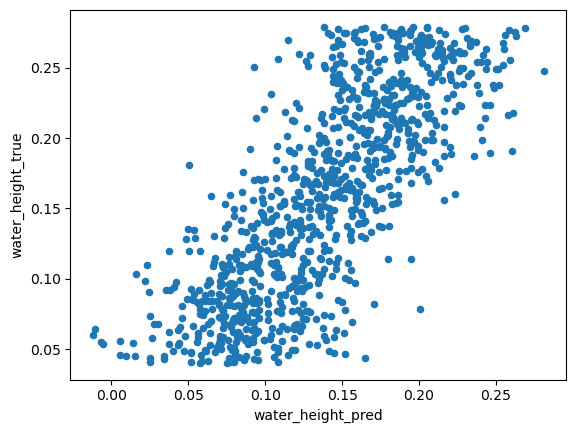

In [33]:
# print(labels[0])
water_height_preds = [x for x in predictions[2]]
water_height_true = [x[3] for x in y_val[:1000]]
# print(np.shape(water_height_true))
df1 = pd.DataFrame(water_height_true, columns=['water_height_true'])
df2 = pd.DataFrame(water_height_preds, columns = ['water_height_pred'])
df = pd.concat([df1, df2], axis=1)
print(df['water_height_pred'].corr(df['water_height_true']))
df.plot.scatter('water_height_pred', 'water_height_true')
# print(df)


In [34]:
#print("Predictions 0:", predictions[0])
#print("Predictions 1:", predictions[1])
#print("Predictions 2:", predictions[2])
# print(predictions)

legoXPred = [i[0] for i in predictions[0]]
print(max([max(x) for x in predictions[6]]))

legoYPred = [i[1] for i in predictions[0]]
legoRotPred = predictions[1].tolist()
waterHeight = predictions[2].tolist()
# print(legoRotPred)
legoLengthPred = [i[0] for i in predictions[3]]
legoWidthPred = [i[1] for i in predictions[3]]
legoHeightPred = predictions[4].tolist()
legoShapePred = backend.sigmoid(predictions[5].tolist())
cameraXPred = [i[0] for i in predictions[6]]
cameraYPred = [i[1] for i in predictions[6]]
cameraZPred = [i[2] for i in predictions[6]]
# print(len(legoShapePred))
trueX = [i[0] for i in actual]
trueY = [i[1] for i in actual]
trueRot = [i[2] for i in actual]
trueWaterHeight = [i[3] for i in actual]
lightX = [i[4] for i in actual]
lightY = [i[5] for i in actual]
lightZ = [i[6] for i in actual]
lego_length = [i[7] for i in actual]
lego_width = [i[8] for i in actual]
lego_height = [i[9] for i in actual]
cameraX = [i[10] for i in actual]
cameraY = [i[11] for i in actual]
cameraZ = [i[12] for i in actual]
trueShape = [i[13:] for i in actual]

#print(legoXPred)
#for i in TrueShape[0]:
#    print(i)
#print(trueShape[0])
#print(np.reshape(backend.sigmoid(LegoShapePred[0]), (7,5,3)).tolist())
#print(np.reshape(TrueShape[0], (7,5,3)).tolist())
#temp = [LegoXPred[0], LegoYPred[0], LegoRotPred[0][0], backend.sigmoid(LegoShapePred[0]), TrueX[0], TrueY[0], TrueRot[0], len(TrueShape[0])]
#print(temp)
#temp = [0 if x < 0.5 else 1 for x in backend.sigmoid(LegoShapePred[0])]
#avg = sum(LegoShapePred[0]) / len(LegoShapePred[0])
#temp = [0 if x < avg else 1 for x in LegoShapePred[0]]

#print(avg)
#print(LegoShapePred[3])
#print("Max:", max(LegoShapePred[3]))
#print("Min:", min(LegoShapePred[3]))
#print(len(LegoShapePred[3]))
#print(sum([x>avg for x in LegoShapePred[3]]))

#print(sum(TrueShape[0]))
#print(sum(temp))
def dice_coef_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)

def dice_coef(y_true, y_pred):  
    #print(y_true)
    y_true_f = backend.flatten(y_true)
    y_pred_f = backend.flatten(y_pred)
    #print("---------------->", y_true_f)
    #print("---------------->", y_pred_f)
    #y_pred_f = tf.where(y_pred_f < 0.5, 0., 1.)
    #y_pred_f = backend.sigmoid(y_pred_f)


    intersection = backend.sum(y_true_f * y_pred_f)
    dice = (2. * intersection + 0.00001) / (backend.sum(y_true_f) + backend.sum(y_pred_f) + 0.00001)
    #print(np.shape(dice), "<---------------------------")
    return dice
#print(dice_coef_loss(LegoShapePred[0], TrueShape[0]))

#print(predictions)
#print(legoRotPred)

# for i in range(len(legoRotPred)):
#     break
#     true_x = 1*backend.sin(legoRotPred[i][0])
#     true_y = 1*backend.cos(legoRotPred[i][0])
    
#     pred_x = backend.cast(1*backend.sin(trueRot[i]), backend.floatx())
#     pred_y = backend.cast(1*backend.cos(trueRot[i]), backend.floatx())
#     print(true_x)
#     print(true_y)
#     print(pred_x)
#     print(pred_y)
#     dot_product = true_x * pred_x + true_y * pred_y
    
    
#     print(legoRotPred[i][0])
#     print(trueRot[i])
#     print(abs(dot_product), '\n')
    #3.1415927 - backend.abs(backend.abs(y_true_f - y_pred_f)-3.1415927)
#print(np.shape(x_val[0]))
# print(len(x_val[1400]))
#print(x_val[0])




0.93884754


1/1 [==============================] - 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(5, 64, 64, 64)


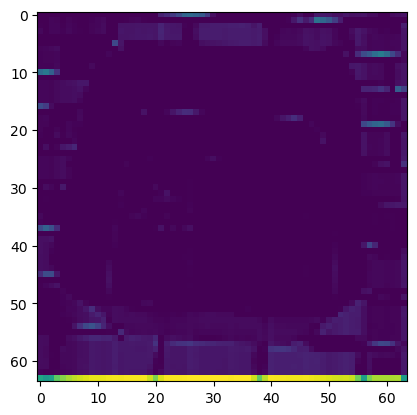

In [35]:
#first_block = model.get_layer('layer_0').output
#print(first_block)
#print(first_block[1, 1,:,:])
#img = first_block[1, 1,:,:]
#print(np.shape(x_val[:5]))
img = x_val[:5]
# show activation of first layer (assume model is trained)
# create a new model
layer_name = "layer_1"
intermediate_model = Model(inputs=model.input, outputs=model.get_layer(layer_name).output)
intermediate_output = intermediate_model.predict(img)

print(np.shape(intermediate_output))
#for i in range(64):

plt.imshow(x_val[4])
plt.imshow(intermediate_output[4,:,:,41])

<Figure size 640x480 with 0 Axes>

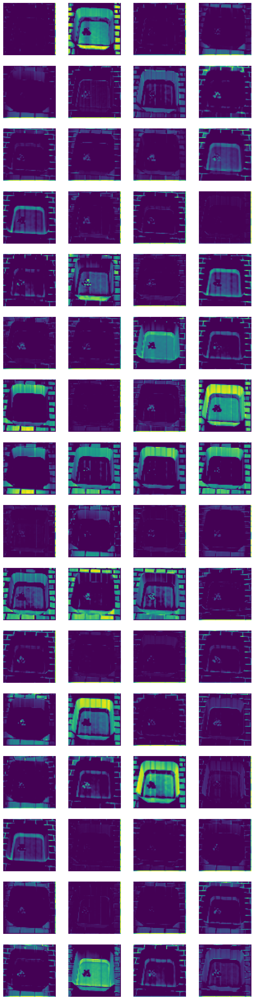

(5, 64, 64, 64)


In [36]:
#plt.imshow(intermediate_output[4,:,:,40], cmap='gray')
plt.figure()
rows = 16
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(10, 40))

if rows > 1:
    axs = axs.flat

for i in range(rows*cols):
    axs[i].imshow(intermediate_output[4,:,:,i])
    axs[i].axis('off')
plt.show()
print(np.shape(intermediate_output))
#plt.imshow(intermediate_output[4,:,:,3])

In [37]:
headerPred = ["LegoXPred", "LegoYPred", "LegoRotPred", "WaterHeight", 
              "lego_length_Pred", "lego_width_Pred", "lego_height_Pred", 
              "cameraX", "cameraY", "cameraZ", "LegoShapePred"]
with open(f'{picture_folder}Metadata\\RecreatedImageData.csv', 'w', encoding='UTF8', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(headerPred)
    for i in range(numPredictions):
        #print(i)
        avg = sum(legoShapePred[i]) / len(legoShapePred[i])
        temp = [0 if x < avg else 1 for x in legoShapePred[i]]
        row = [legoXPred[i], legoYPred[i], legoRotPred[i][0], 
               waterHeight[i][0], 
               legoLengthPred[i], legoWidthPred[i], legoHeightPred[i][0],
               cameraXPred[i], cameraYPred[i], cameraZPred[i],
               np.reshape(temp, (7,5,3)).tolist()]
                
#         print(row)

        writer.writerow(row)
        
headerTrue = ["LegoX", "LegoY", "LegoRot", "WaterHeight", "LightX", "LightY", "LightZ",
              "lego_length", "lego_width", "lego_height", "cameraX", "cameraY", "cameraZ", "TrueShape"]
with open(f'{picture_folder}Metadata\\TrueImageData.csv', 'w', encoding='UTF8', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(headerTrue)
    for i in range(numPredictions):

        row = [trueX[i], trueY[i], trueRot[i], trueWaterHeight[i], 
               lightX[i], lightY[i], lightZ[i], 
               lego_length[i], lego_width[i], lego_height[i], cameraX[i], cameraY[i], cameraZ[i],
               np.reshape(trueShape[i], (7,5,3)).tolist()]
        #print(row)
        writer.writerow(row)
#print(type(x_val[0]))        
for i in range(len(x_val)):
    break
    img = Image.fromarray(x_val[i], 'RGB')
    img.save(f"{picture_folder}Predictions\\image_{i}_Actual.jpg")
    


In [38]:
dfPred = pd.read_csv(f'{picture_folder}Metadata\\RecreatedImageData.csv')
print(dfPred)
dfTrue = pd.read_csv(f'{picture_folder}Metadata\\TrueImageData.csv')

     LegoXPred  LegoYPred  LegoRotPred  WaterHeight  lego_length_Pred  \
0     0.056975  -0.049496     0.868093     0.023294          6.285074   
1    -0.033420   0.019090    -0.632091     0.154288          5.175653   
2    -0.057497  -0.002957     1.286964     0.078050          5.222859   
3    -0.004243   0.052327    -0.471225     0.080128          5.373499   
4     0.075307  -0.010159    -0.409468     0.145582          5.612103   
..         ...        ...          ...          ...               ...   
995  -0.092094  -0.063843    -0.563535     0.119634          4.868890   
996  -0.014075  -0.001845    -0.381329     0.262284          5.183193   
997  -0.074508  -0.016285     0.511365     0.164375          5.167226   
998  -0.034044   0.059163     0.112692     0.084974          5.493894   
999   0.089623  -0.038404    -0.005886     0.141187          6.488145   

     lego_width_Pred  lego_height_Pred   cameraX   cameraY   cameraZ  \
0           2.778400          2.440116  0.067426  0

In [39]:
# """ Create Comparison Document """

header = ["LegoXPred", "LegoYPred", "LegoRotPred", "WaterHeightPred", 
          "lego_length_Pred", "lego_width_Pred", "lego_height_Pred",
          "cameraXPred", "cameraYPred", "cameraZPred",
          "LegoXTrue", "LegoYTrue", "LegoRotTrue", "WaterHeightTrue", 
          "lego_length_True", "lego_width_True", "lego_height_True",
          "cameraXTrue", "cameraYTrue", "cameraZTrue",
          "LegoXComp", "LegoYComp", "LegoRotComp", "WaterHeightComp", 
          "lego_length_Comp", "lego_width_Comp", "lego_height_Comp", 
          "cameraXComp", "cameraYComp", "cameraZComp", "shapePred", "shapeTrue"
         
         ]
dfPred = pd.read_csv(f'{picture_folder}Metadata\\RecreatedImageData.csv')
dfTrue = pd.read_csv(f'{picture_folder}Metadata\\TrueImageData.csv')

def dot_prod(pred, true):
    true_x = math.sin(true)
    true_y = math.cos(true)
    
    pred_x = math.sin(pred)
    pred_y = math.cos(pred)
    
    return true_x*pred_x + true_y*pred_y

with open(f'{picture_folder}Metadata\\ComparedImageData.csv', 'w', encoding='UTF8', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(header)
    for i in range(numPredictions):
        compX = dfPred["LegoXPred"][i] - dfTrue["LegoX"][i]
        compY = dfPred["LegoYPred"][i] - dfTrue["LegoY"][i]
        compRot = dot_prod(dfPred["LegoRotPred"][i], dfTrue["LegoRot"][i])
        compWater = dfPred["WaterHeight"][i] - dfTrue["WaterHeight"][i]
        compLength = dfPred["lego_length_Pred"][i] - dfTrue["lego_length"][i]
        compWidth = dfPred["lego_width_Pred"][i] - dfTrue["lego_width"][i]
        compHeight = dfPred["lego_height_Pred"][i] - dfTrue["lego_height"][i]
        compCamX = dfPred["cameraX"][i] - dfTrue["cameraX"][i]
        compCamY = dfPred["cameraY"][i] - dfTrue["cameraY"][i]
        compCamZ = dfPred["cameraZ"][i] - dfTrue["cameraZ"][i]
        row = [dfPred["LegoXPred"][i], dfPred["LegoYPred"][i],
               dfPred["LegoRotPred"][i], dfPred["WaterHeight"][i], 
               dfPred["lego_length_Pred"][i], dfPred["lego_width_Pred"][i], dfPred["lego_height_Pred"][i],
               dfPred["cameraX"][i], dfPred["cameraY"][i], dfPred["cameraZ"][i],
               dfTrue["LegoX"][i], dfTrue["LegoY"][i], 
               dfTrue["LegoRot"][i], dfTrue["WaterHeight"][i],
               dfTrue["lego_length"][i], dfTrue["lego_width"][i], dfTrue["lego_height"][i],
               dfTrue["cameraX"][i], dfTrue["cameraY"][i], dfTrue["cameraZ"][i],
               compX, compY, compRot, compWater, compLength, compWidth, compHeight, 
               compCamX, compCamY, compCamZ, dfPred["LegoShapePred"][i], dfTrue["TrueShape"][i]
              ]
        writer.writerow(row)

In [40]:
dfComp = pd.read_csv(f'{picture_folder}Metadata\\ComparedImageData.csv')
print(dfComp)

     LegoXPred  LegoYPred  LegoRotPred  WaterHeightPred  lego_length_Pred  \
0     0.056975  -0.049496     0.868093         0.023294          6.285074   
1    -0.033420   0.019090    -0.632091         0.154288          5.175653   
2    -0.057497  -0.002957     1.286964         0.078050          5.222859   
3    -0.004243   0.052327    -0.471225         0.080128          5.373499   
4     0.075307  -0.010159    -0.409468         0.145582          5.612103   
..         ...        ...          ...              ...               ...   
995  -0.092094  -0.063843    -0.563535         0.119634          4.868890   
996  -0.014075  -0.001845    -0.381329         0.262284          5.183193   
997  -0.074508  -0.016285     0.511365         0.164375          5.167226   
998  -0.034044   0.059163     0.112692         0.084974          5.493894   
999   0.089623  -0.038404    -0.005886         0.141187          6.488145   

     lego_width_Pred  lego_height_Pred  cameraXPred  cameraYPred  cameraZPr

In [41]:
#print(df)
legoXCompSum = dfComp["LegoXComp"].sum()
legoYCompSum = dfComp["LegoYComp"].sum()
df["LegoRotComp"] = dfComp["LegoRotComp"] % math.pi
legoRotCompSum = dfComp["LegoRotComp"].sum()
WaterHeightCompSum   = dfComp["WaterHeightComp"].sum()
lego_length_CompSum = dfComp["lego_length_Comp"].sum()
lego_width_CompSum = dfComp["lego_width_Comp"].sum()
lego_height_CompSum = dfComp["lego_height_Comp"].sum()

lego_length_True = dfTrue["lego_length"]
lego_width_True = dfTrue["lego_width"]
lego_height_True = dfTrue["lego_height"]

lego_length_Pred = dfPred["lego_length_Pred"]
lego_width_Pred = dfPred["lego_width_Pred"]
lego_height_Pred = dfPred["lego_height_Pred"]

cameraX = dfTrue["cameraX"]
cameraY = dfTrue["cameraY"]
cameraZ = dfTrue["cameraZ"]

#print()

def calculateDistanceToRefractedPosition(legoPos, cameraPos, waterHeight):
    #print(cameraPos[0])
   # print(legoPos[0])
    vec = (cameraPos[0]-legoPos[0], cameraPos[1]-legoPos[1], cameraPos[2]-legoPos[2])
    cos_a = vec[2] / (math.sqrt(pow(vec[0], 2)+pow(vec[1], 2)+pow(vec[2], 2)))
    angle1 = math.acos(cos_a)
    
    ior = 1.333
    angle2 = math.asin(math.sin(angle1)/ior)
    
    waterToLegoHeight = waterHeight-legoPos[2]
    distance = waterToLegoHeight * math.tan(angle2)
    
    return distance

avgDistance = 0
avgMiss = 0
avgError = 0
totalMisses = 0
headerDistance = ["RefractedDistance", "PredictionMiss", "error", "WaterHeight"]
with open(f'{picture_folder}Metadata\\DistanceData.csv', 'w', encoding='UTF8', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(headerDistance)
    for i in range(numPredictions):
        x = dfComp["LegoXComp"][i]
        y = dfComp["LegoYComp"][i]
        miss = math.sqrt(pow(x, 2) + pow(y, 2))

        legoPoint = (dfTrue["LegoX"][i], dfTrue["LegoY"][i], 0.15)
        cameraPoint = (cameraX[i], cameraY[i], cameraZ[i])
        waterHeight = dfPred["WaterHeight"][i]
        distance = calculateDistanceToRefractedPosition(legoPoint, cameraPoint, waterHeight)
        row = [distance, miss, abs(distance-miss), waterHeight]
        writer.writerow(row)
        #
        #print(f"True distance: {distance}\n    Pred miss: {miss}\n        Error: {abs(distance-miss)}\n   waterHeight: {waterHeight}\n\n")
        #avgDistance += distance
        totalMisses += 1 if miss > distance else 0
        print("   distance:", distance)
        print("       miss:", miss)
        print("waterHeight:", waterHeight)
        print('\n')
print(totalMisses)
        #avgMiss += miss
    
#avgDistance = avgDistance/50
#avgMiss = avgMiss/50
#avgError = abs(avgDistance-avgMiss)

#print(f"True distance: {avgDistance}\n    Pred miss: {avgMiss}\n        Error: {avgError}\n")



    
    #for i in range(50):
        
        #print(row)
        

# print("Average X miss: ", legoXCompSum/50)
# print("Average Y miss: ", legoYCompSum/50)
# print("Average Rot miss: ", legoRotCompSum/50)
# print("Average Water miss: ", WaterHeightCompSum/50)
# print("Average Length miss: ", lego_length_CompSum/50)
# print("Average width miss: ", lego_width_CompSum/50)
# print("Average height miss: ", lego_height_CompSum/50)

# for i in range(50):
#     img_actual = Image.open(f'C:\\Users\\Matias\\_Thesis\\Project-Blender\\Pictures\\Predictions\\image_{i}_Actual.jpg').convert('RGB')
#     img_pred = Image.open(f'C:\\Users\\Matias\\_Thesis\\Project-Blender\\Pictures\\Predictions\\image_{i}_Pred.png').convert('RGB')
#     img_true = Image.open(f'C:\\Users\\Matias\\_Thesis\\Project-Blender\\Pictures\\Predictions\\image_{i}_True.png').convert('RGB')
    
#     new_size = (128, 128)
    
#     # Resize the image
#     img_actual = img_actual.resize(new_size)
#     img_pred = img_pred.resize(new_size)
#     img_true = img_true.resize(new_size)
    
#     im_combined = Image.new('RGB', (img_actual.width + img_pred.width + img_true.width, img_true.height))
#     im_combined.paste(img_actual, (0, 0))
#     im_combined.paste(img_pred, (img_actual.width, 0))
#     im_combined.paste(img_true, (img_actual.width + img_pred.width, 0))

#     # Display the resized image
#     print(f"\n{i}    Actual           Pred             True")
#     display(im_combined)
#     print(f"   {int(lego_length_True[i])}x{int(lego_width_True[i])}x{int(lego_height_True[i])}           {int(lego_length_Pred[i])}x{int(lego_width_Pred[i])}x{int(lego_height_Pred[i])}     \n")
    
#     #display(img_actual.thumbnail((256, 256)))
#     #display(img_pred)
#     #display(img_true)
    

   distance: -0.03524315892771966
       miss: 0.010779682881603669
waterHeight: 0.0232935268431901


   distance: 0.0010340795735132113
       miss: 0.03669262553509741
waterHeight: 0.1542877405881881


   distance: -0.02559526687375402
       miss: 0.04052751979021605
waterHeight: 0.0780499279499054


   distance: -0.012717288636462917
       miss: 0.011661089940847866
waterHeight: 0.0801277756690979


   distance: -0.0014149302413073294
       miss: 0.019534791289960395
waterHeight: 0.1455821543931961


   distance: -0.025397280813884808
       miss: 0.016294960674517835
waterHeight: 0.0768312215805053


   distance: -0.009010451966125092
       miss: 0.015286380730577762
waterHeight: 0.1104637831449508


   distance: 0.031125403981862705
       miss: 0.03641317096809115
waterHeight: 0.2486167401075363


   distance: 0.0024315910579773576
       miss: 0.01599765506177588
waterHeight: 0.1591159999370575


   distance: -0.021966378659677054
       miss: 0.02234231215142869
waterHeight

In [20]:
water_df = dfComp.sort_values(by=['WaterHeightComp'], key=lambda x: abs(x - 0), ascending=False)
rot_df = dfComp.sort_values(by=['LegoRotComp'], ascending=False)
legoX_df = dfComp.sort_values(by=['LegoXComp'], ascending=True)
legoY_df = dfComp.sort_values(by=['LegoYComp'], key=lambda x: abs(x - 0), ascending=True)
loss_df = dfComp.sort_values(by=['Losses'], ascending=True)
# loss_noDim_df = dfComp.sort_values(by=['LossesWithoutDims'], ascending=True)

# print(water_df.head(10).index)
# print(water_df[['WaterHeightComp', 'WaterHeightPred', 'WaterHeightTrue']])
# print(len(water_df.loc[water_df['WaterHeightPred']>0.28]))

# print(legoX_df['LegoXComp'].head(10))
print(legoY_df['LegoYComp'].head(10))
a = rot_df['LegoRotComp'].head(10)
print(dfComp.head(10).index)
for i in dfComp.head(10).index:
    print(i)
# print(loss_noDim_df['LossesWithoutDims'].head(10))
# print(len(legoX_df.loc[legoX_df['LegoXComp']>0.03]))

# print(len(legoX_df.loc[legoX_df['LegoYComp']>0.05]))

# print(legoX_df[['LegoXComp', 'LegoXPred', 'LegoXTrue']].head(10))
# print(len(legoX_df.loc[legoX_df['LegoXComp']>0.05]))

# print(legoY_df[['LegoYComp', 'LegoYPred', 'LegoYTrue']].head(10))
# print(len(legoY_df.loc[legoY_df['LegoYComp']>0.05]))

# print(loss_df.head(10).index)
# print(len(water_df.loc[water_df['WaterHeightPred']>0.28]))
print(dfComp.iloc[0])

KeyError: 'Losses'


100-139    Pred             True          Loss = 0.24281202
x-y: -0.06575134x-0.042312887
-0.0688543344835616x-0.0500143767336587
Water height: 0.0826569454816586, comp: 0.0765147251936191


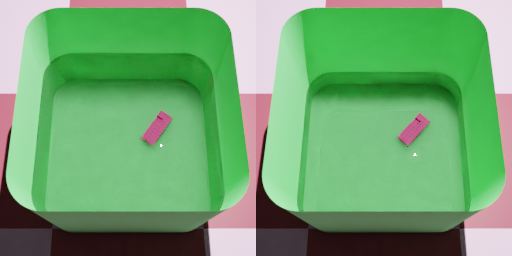

rotPred: 0.957984209060669
rotTrue: 0.8477617947598166
dims: 4.7723875x1.7410828
 5.0x2.0

99-497    Pred             True          Loss = 0.24548383
x-y: -0.041241735x0.024680465
-0.0452872116074171x0.0273776005201703
Water height: 0.1688728792981108, comp: -0.0047568394259412


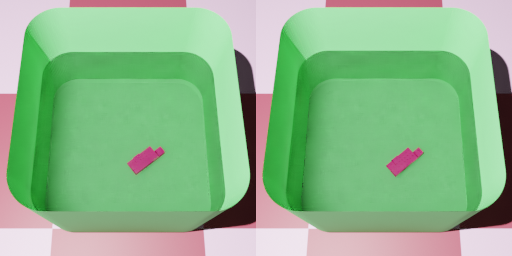

rotPred: 0.6554677486419678
rotTrue: 0.7009029781215574
dims: 5.09138x1.7297106
 5.0x2.0

98-848    Pred             True          Loss = 0.25600204
x-y: 0.080995105x0.07849549
0.0752388005079647x0.0930988367783826
Water height: 0.1346387327784952, comp: 0.0240416615133824


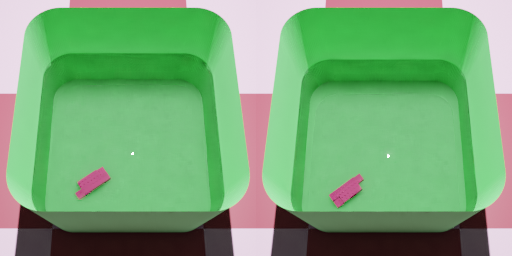

rotPred: 0.5969269275665283
rotTrue: 0.6550077255411897
dims: 4.780872x2.0873005
 5.0x2.0

97-602    Pred             True          Loss = 0.26698506
x-y: -0.057083547x0.082257465
-0.0526720988517167x0.0735060250047511
Water height: 0.0594788891537819, comp: 0.1013016747967567


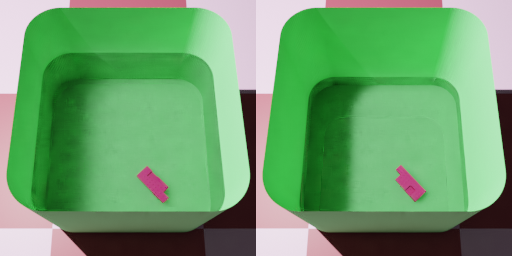

rotPred: 0.7606129805233817
rotTrue: 0.7339355839574075
dims: 4.9524856x2.0085115
 5.0x2.0

96-755    Pred             True          Loss = 0.2753773
x-y: 0.03449555x-0.07615836
0.0333968864876442x-0.0736490944038884
Water height: 0.2098347010449054, comp: -0.0516072871521595


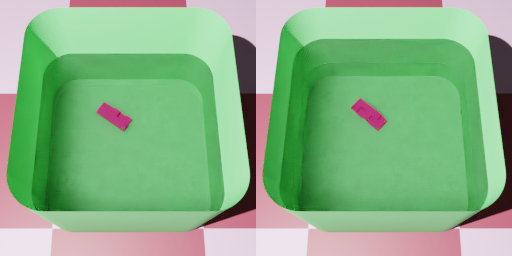

rotPred: 0.9518386284497122
rotTrue: 0.8783308193998063
dims: 4.7373085x1.8502636
 5.0x2.0

95-666    Pred             True          Loss = 0.28621012
x-y: -0.05264105x-0.07965865
-0.0564670441269833x-0.084100613624653
Water height: 0.0644689613338097, comp: 0.0993192529920951


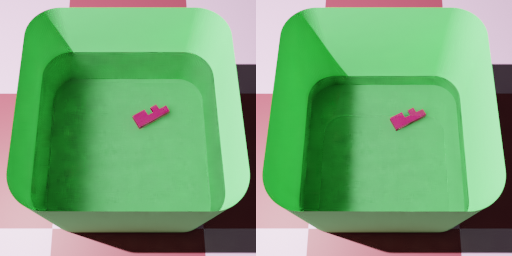

rotPred: 0.5252116918563843
rotTrue: 0.4891297122228345
dims: 5.065872x2.0670414
 5.0x2.0

94-797    Pred             True          Loss = 0.31240425
x-y: 0.045876667x-0.0196708
0.0542150941494859x-0.0301546592621821
Water height: 0.082857585693634, comp: 0.0733676932799454


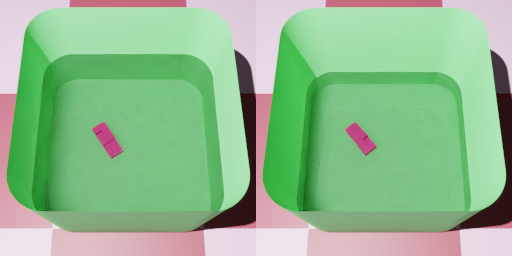

rotPred: 0.5803528587010246
rotTrue: 0.6734544466508074
dims: 4.861288x2.0366607
 5.0x2.0

93-868    Pred             True          Loss = 0.31588116
x-y: -0.050231762x-0.038011845
-0.0490855794577679x-0.0364243785959784
Water height: 0.2313589833377244, comp: -0.070319303095186


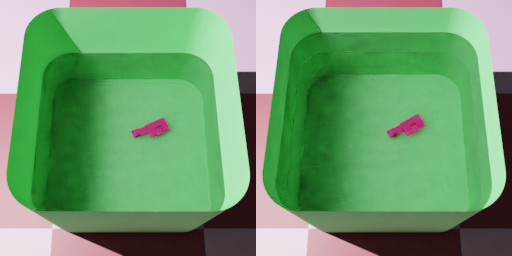

rotPred: 0.4184571206569671
rotTrue: 0.5375069940758453
dims: 4.790053x1.8830867
 5.0x2.0

92-526    Pred             True          Loss = 0.32227123
x-y: -0.0917597x-0.045951158
-0.0968635179411123x-0.0574883572162124
Water height: 0.1274695945142651, comp: 0.0357602434993838


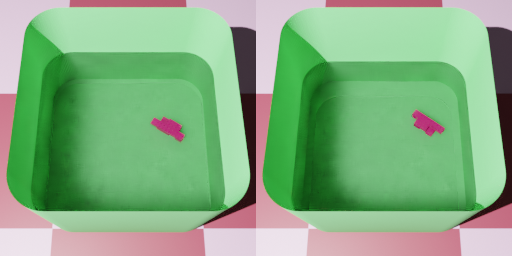

rotPred: 1.008700923123632
rotTrue: 0.9378583753675365
dims: 5.035655x1.6611803
 5.0x2.0

91-175    Pred             True          Loss = 0.3270595
x-y: 0.015448129x-0.04820646
0.0139208130333606x-0.0438604857181146
Water height: 0.2326539471562789, comp: -0.0707894280370162


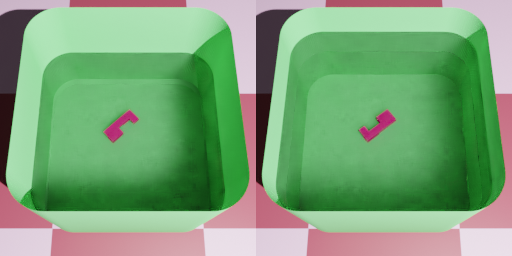

rotPred: 0.7479411363601685
rotTrue: 0.6642809808071051
dims: 4.7643714x1.8203552
 5.0x2.0

90-963    Pred             True          Loss = 0.34087172
x-y: -0.08841338x-0.033435512
-0.0852179084172109x-0.0349721862163442
Water height: 0.2172765667023427, comp: -0.0553996200146443


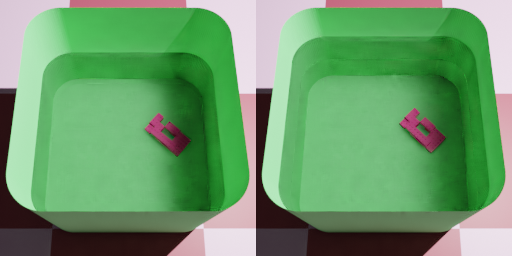

rotPred: 0.8406652967121939
rotTrue: 0.7840649426194553
dims: 5.714636x3.173604
 6.0x3.0

89-566    Pred             True          Loss = 0.34700477
x-y: 0.012252356x-0.061438713
0.0125338485283773x-0.0643746650806088
Water height: 0.1227241790211474, comp: 0.0380587691151821


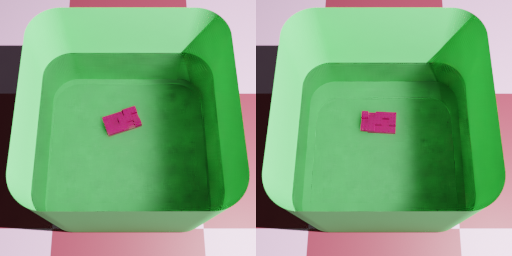

rotPred: 0.3326989114284515
rotTrue: 1.5184437304174785
dims: 5.137198x2.7455416
 5.0x3.0

88-420    Pred             True          Loss = 0.35619843
x-y: 0.007461013x-0.016389087
0.0022775081768373x-0.0172807410627185
Water height: 0.1032578907319796, comp: 0.0588273741892086


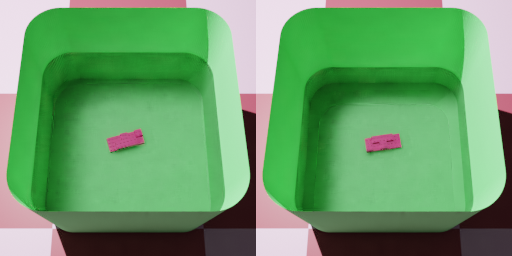

rotPred: 0.2694141864776611
rotTrue: 0.15785639877675006
dims: 4.7577677x2.047191
 5.0x2.0

87-243    Pred             True          Loss = 0.3800399
x-y: -0.0679337x0.008253786
-0.0657714081195685x0.0060106606458401
Water height: 0.1070231056206057, comp: 0.0598723435409238


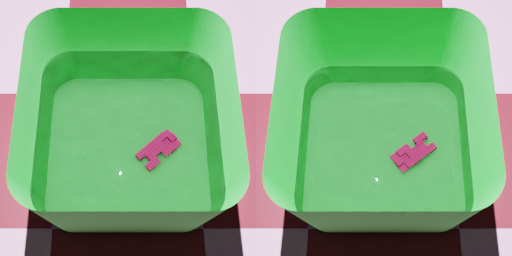

rotPred: 0.7087412476539612
rotTrue: 0.6396555095425582
dims: 5.752114x2.6412878
 6.0x3.0

86-957    Pred             True          Loss = 0.39334252
x-y: -0.06867819x-0.020387568
-0.082975594623069x-0.0169027683142014
Water height: 0.1111408008357933, comp: 0.051114039299781


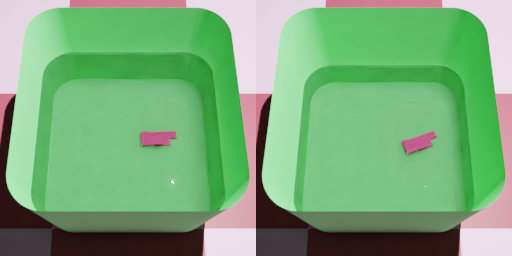

rotPred: 0.0400877110660076
rotTrue: 0.359127421428325
dims: 4.9769077x1.855876
 5.0x2.0

85-758    Pred             True          Loss = 0.40388834
x-y: 0.03489338x0.0013993965
0.0274966737293515x0.0055882417308923
Water height: 0.2162651574205963, comp: -0.0557898139547912


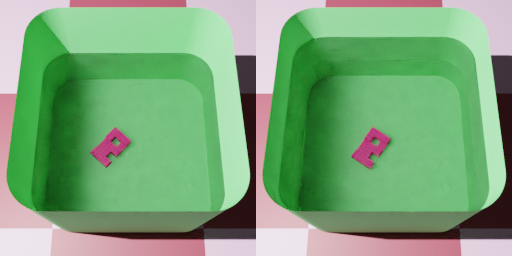

rotPred: 0.8289774656295776
rotTrue: 0.9819710793613844
dims: 5.055858x2.5360699
 5.0x3.0

84-568    Pred             True          Loss = 0.40719604
x-y: 0.022643864x0.038857374
0.0300325737709831x0.0311585601895215
Water height: 0.1850494471300251, comp: -0.0258341756570942


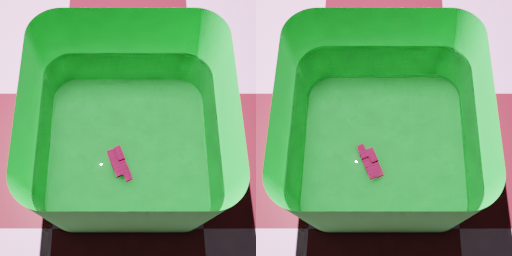

rotPred: 0.3581732074406485
rotTrue: 0.39093460514298584
dims: 4.760807x1.5086062
 5.0x2.0

83-518    Pred             True          Loss = 0.409647
x-y: -0.032703206x-0.054328512
-0.0400483571202064x-0.0566961289162206
Water height: 0.2596728012384958, comp: -0.0936030701222009


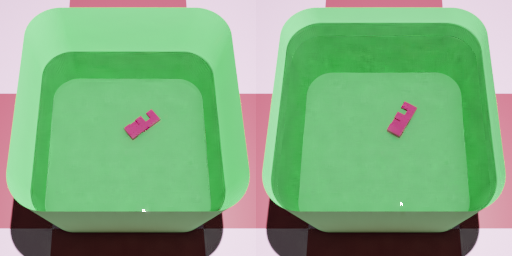

rotPred: 0.6594913005828857
rotTrue: 1.046802627451439
dims: 4.9399543x1.8441613
 5.0x2.0

82-825    Pred             True          Loss = 0.41075498
x-y: -0.0743675x-0.0635321
-0.0810076713123898x-0.0633123790497667
Water height: 0.1693293992923909, comp: -0.0087350104498082


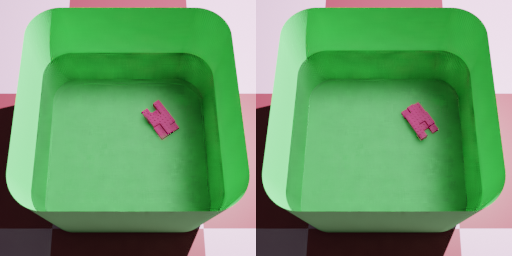

rotPred: 0.6005092422154288
rotTrue: 0.5683530472706555
dims: 5.3979073x2.8721225
 5.0x3.0

81-574    Pred             True          Loss = 0.41127878
x-y: -0.057616033x-0.06471479
-0.060240420860399x-0.0661625167622183
Water height: 0.2130708229173092, comp: -0.0483291279900937


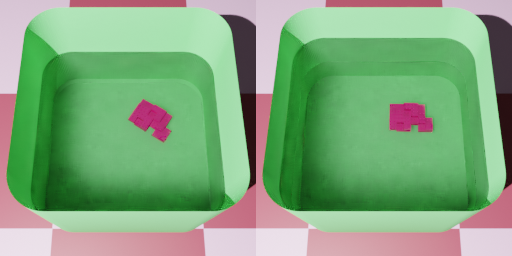

rotPred: 0.9884262839939932
rotTrue: 1.5454713898103387
dims: 6.076332x3.8710818
 6.0x4.0

80-258    Pred             True          Loss = 0.41847366
x-y: 0.07807895x-0.08332042
0.0691710859549265x-0.0933885872161922
Water height: 0.1438022390063656, comp: 0.0139953210894213


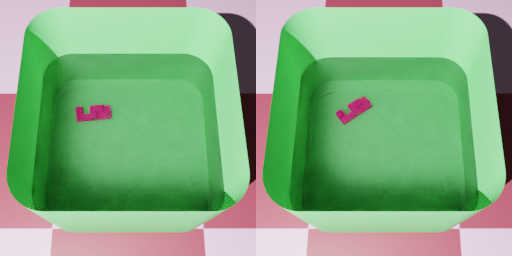

rotPred: 0.1027431041002273
rotTrue: 0.6151055364597435
dims: 5.107582x1.9496619
 5.0x2.0

79-485    Pred             True          Loss = 0.42159116
x-y: -0.0812218x0.02454818
-0.0805986208896196x0.0226608668264776
Water height: 0.193039886654703, comp: -0.0314122214926165


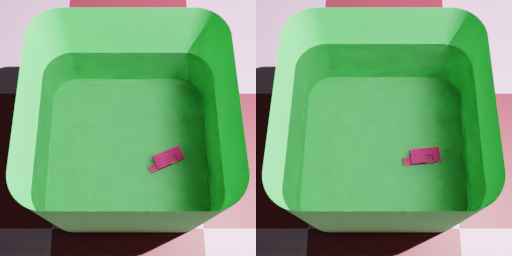

rotPred: 0.3949576318264007
rotTrue: 0.0876523121118308
dims: 5.1624546x2.2313476
 5.0x2.0

78-605    Pred             True          Loss = 0.42608285
x-y: 0.03174273x-0.041750684
0.0328447799354313x-0.0512344340587547
Water height: 0.0405853468162228, comp: 0.119575731160004


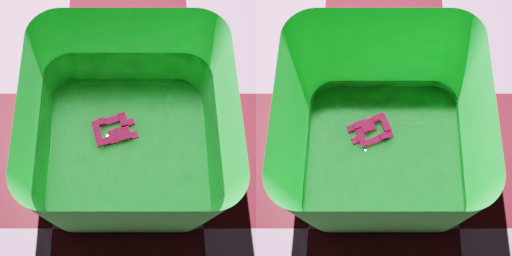

rotPred: 0.2619915902614593
rotTrue: 0.38023495582309774
dims: 5.720051x3.7767434
 6.0x4.0

77-216    Pred             True          Loss = 0.4262107
x-y: -0.008427899x0.028993845
-0.0155869488944235x0.0279431367602626
Water height: 0.1893561123019481, comp: -0.0258559374219204


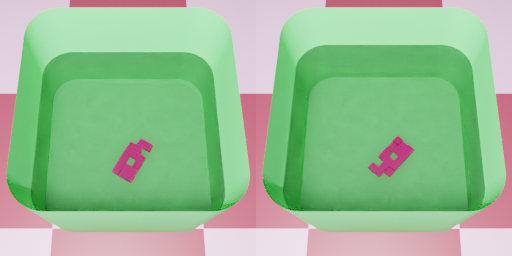

rotPred: 1.0346136093139648
rotTrue: 0.8365556043281317
dims: 5.459496x2.950263
 6.0x3.0

76-949    Pred             True          Loss = 0.42631778
x-y: 0.010495676x-0.06604575
0.0142653862255463x-0.0666330323877105
Water height: 0.1713213984784586, comp: -0.0113457207498056


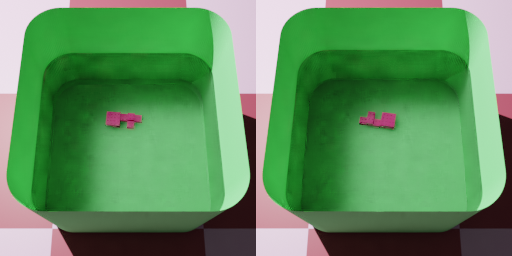

rotPred: 1.4908850649979453
rotTrue: 1.416612902783993
dims: 4.8473115x2.12876
 5.0x2.0

75-503    Pred             True          Loss = 0.4321306
x-y: -0.07727533x0.020114828
-0.0804664884725931x0.0230375782062754
Water height: 0.1985612578035701, comp: -0.0373014725090374


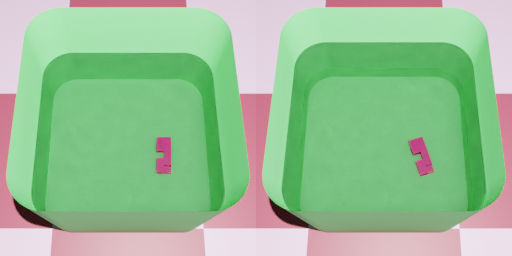

rotPred: 1.5398392995172223
rotTrue: 0.3019395619713787
dims: 5.3133326x1.8847698
 5.0x2.0

74-950    Pred             True          Loss = 0.43572143
x-y: -0.08644364x0.08092864
-0.0969683815450258x0.0843700488736298
Water height: 0.2381849508861915, comp: -0.0728818398098365


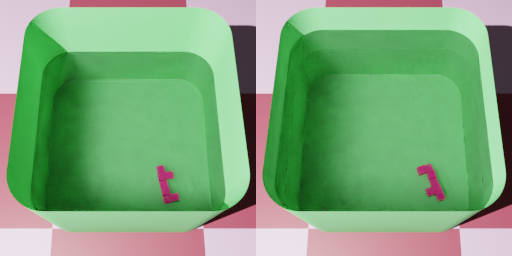

rotPred: 0.19199021259811944
rotTrue: 0.33798447543370824
dims: 5.1199503x2.2469769
 5.0x2.0

73-174    Pred             True          Loss = 0.43687516
x-y: 0.048373498x-0.0104596075
0.0417962190032828x-0.0170596332674982
Water height: 0.2788188046065801, comp: -0.1170603668538564


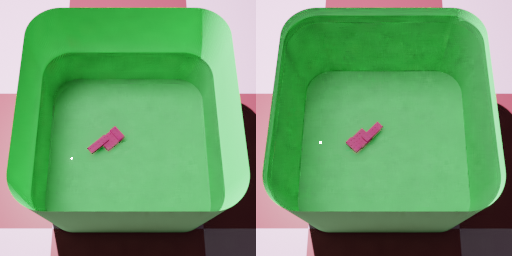

rotPred: 0.7171874046325684
rotTrue: 0.8033593465557627
dims: 4.9731307x1.9704195
 5.0x2.0

72-17    Pred             True          Loss = 0.4394682
x-y: -0.088433534x0.068828076
-0.0899162070221699x0.0609740194328934
Water height: 0.2731841282650111, comp: -0.1103205756946681


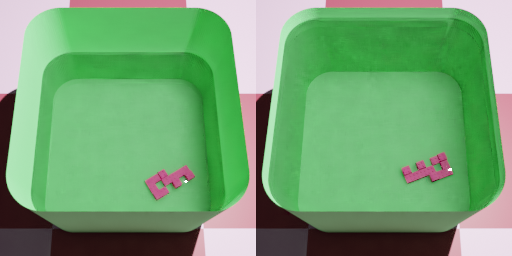

rotPred: 0.535030722618103
rotTrue: 0.36658862933292546
dims: 6.0098143x3.209889
 6.0x3.0

71-421    Pred             True          Loss = 0.44898722
x-y: -0.076986864x0.005218354
-0.0869837733199115x0.0062571016207513
Water height: 0.1964417463197269, comp: -0.0352738564862766


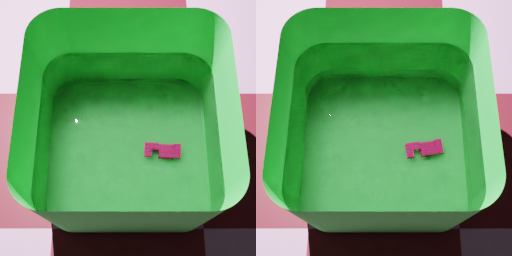

rotPred: 1.5180031257357935
rotTrue: 0.135277010264271
dims: 5.1519523x2.2892995
 5.0x2.0

70-616    Pred             True          Loss = 0.4555049
x-y: -0.05065752x0.06201413
-0.0553125465016412x0.0568560915192949
Water height: 0.1935579674017685, comp: -0.0348987476599472


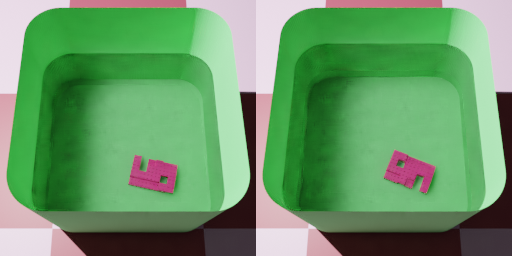

rotPred: 1.3432009826090674
rotTrue: 1.187686718769947
dims: 5.5907903x3.6663132
 6.0x4.0

69-766    Pred             True          Loss = 0.45637614
x-y: -0.02842947x-0.07123042
-0.0334861287929447x-0.0703392665861027
Water height: 0.1577553394084957, comp: 0.004499843453786


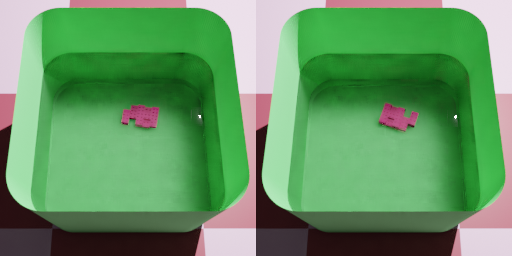

rotPred: 1.4127570251610617
rotTrue: 1.2414774830836213
dims: 5.1364503x2.4773586
 5.0x3.0

68-124    Pred             True          Loss = 0.46124944
x-y: 0.061088406x0.014026999
0.0589036974486651x0.0156638800668098
Water height: 0.1683260446221647, comp: -0.0121905153424558


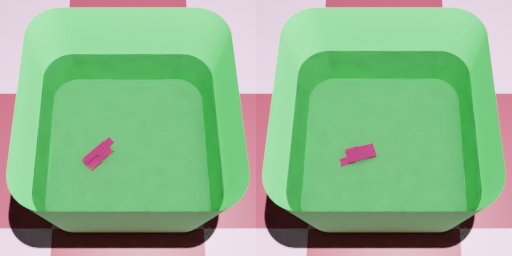

rotPred: 0.7438554763793945
rotTrue: 0.2730170695457921
dims: 4.83644x1.9486291
 5.0x2.0

67-85    Pred             True          Loss = 0.46199104
x-y: -0.057983197x-0.0028031534
-0.0656783998540097x-0.0045623773288843
Water height: 0.1697979758978725, comp: -0.0086466859579922


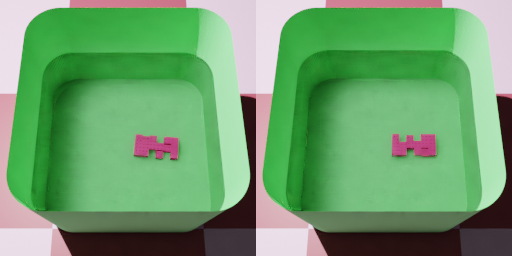

rotPred: 1.4756873855975012
rotTrue: 1.5620512292951743
dims: 5.412878x3.159049
 6.0x3.0

66-348    Pred             True          Loss = 0.4667892
x-y: 0.04001113x0.023275513
0.0499674832211198x0.0183674061115413
Water height: 0.1306969530190098, comp: 0.0314890288506876


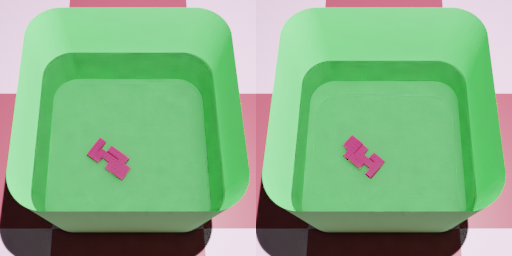

rotPred: 0.9420413533833365
rotTrue: 0.8763005527769834
dims: 5.5400095x3.0818253
 6.0x3.0

65-67    Pred             True          Loss = 0.46782622
x-y: 0.072322994x-0.056888156
0.0732272099943479x-0.0552933107821337
Water height: 0.2734301471233473, comp: -0.1120346718549833


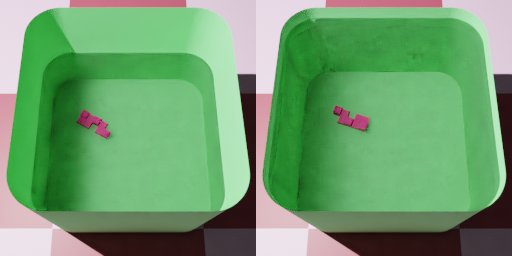

rotPred: 1.049776748814855
rotTrue: 1.2340934500341145
dims: 5.112027x2.2617583
 5.0x2.0

64-241    Pred             True          Loss = 0.47064632
x-y: 0.07042277x0.06097537
0.0638193043865212x0.0612590425247113
Water height: 0.0777199808099787, comp: 0.0803860482236821


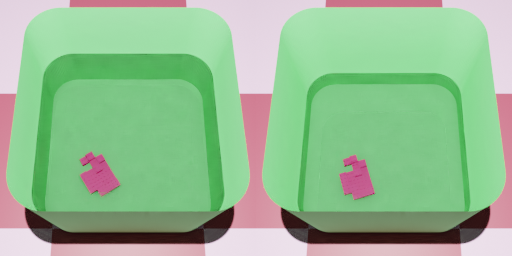

rotPred: 0.5544067184117178
rotTrue: 0.29932792079924475
dims: 6.02932x3.6179132
 6.0x4.0

63-134    Pred             True          Loss = 0.47577655
x-y: 0.053451866x0.03704259
0.0570157125841613x0.0441474615031257
Water height: 0.2750007775792421, comp: -0.1132842269906342


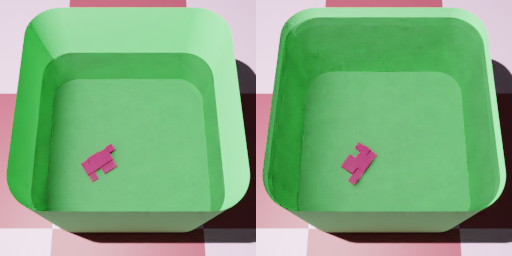

rotPred: 0.5923080444335938
rotTrue: 0.9638491813710779
dims: 5.1439347x2.4946723
 5.0x3.0

62-374    Pred             True          Loss = 0.4763214
x-y: -0.082101144x0.07971102
-0.0771574187252915x0.063488773723891
Water height: 0.1911553161619539, comp: -0.0248353945492143


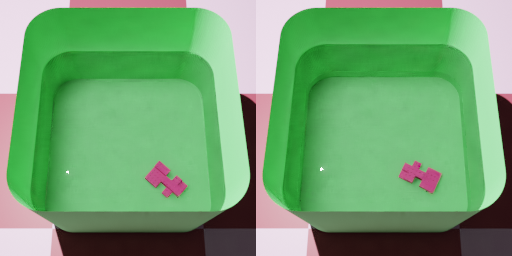

rotPred: 0.8378511230137686
rotTrue: 1.0944160213513605
dims: 5.3687906x2.7362628
 5.0x3.0

61-845    Pred             True          Loss = 0.4784048
x-y: -0.027482422x-0.051906183
-0.0269951100961721x-0.045007469462028
Water height: 0.2289787989460577, comp: -0.0643926572405446


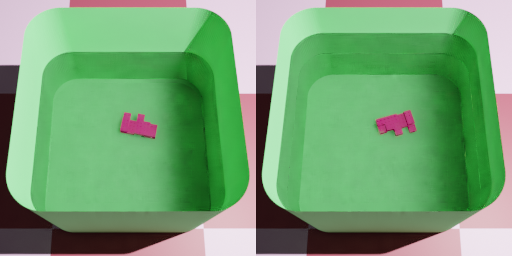

rotPred: 1.3687551925566535
rotTrue: 0.2895178101326148
dims: 5.2116528x2.8530354
 5.0x3.0

60-680    Pred             True          Loss = 0.48151106
x-y: 0.031653866x0.043803975
0.0425942722070752x0.0373556467071571
Water height: 0.1962478389004835, comp: -0.0374628235558638


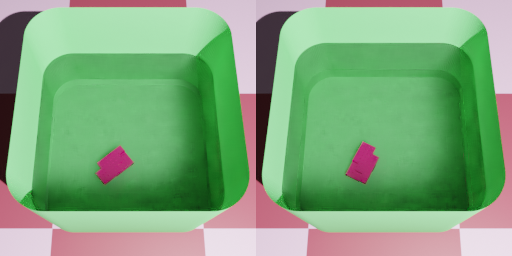

rotPred: 0.6786185503005981
rotTrue: 1.1082906204086438
dims: 4.8561726x2.498375
 5.0x3.0

59-419    Pred             True          Loss = 0.4847166
x-y: 0.051883467x0.020112518
0.0461008877457517x0.0184121644574783
Water height: 0.2551030101145972, comp: -0.0933434398736227


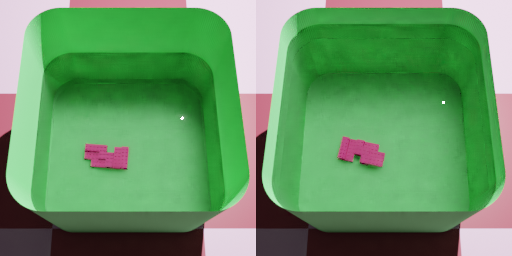

rotPred: 1.4908358166601996
rotTrue: 1.3693812048800953
dims: 5.4516935x3.008934
 6.0x3.0

58-99    Pred             True          Loss = 0.4851613
x-y: 0.03109183x-0.082830265
0.0353941024535114x-0.0902787190420875
Water height: 0.0574534635852548, comp: 0.1044085670400885


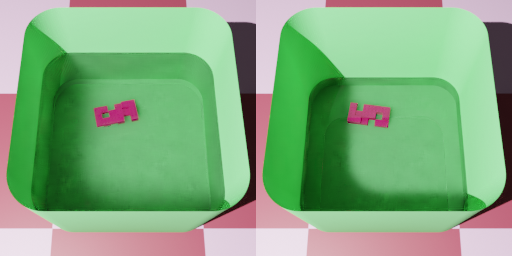

rotPred: 0.2002836763858795
rotTrue: 1.4298968805730277
dims: 5.6301823x3.2801452
 6.0x3.0

57-638    Pred             True          Loss = 0.4904015
x-y: 0.04552973x0.004222355
0.044790215991192x0.0085618146181078
Water height: 0.1342806171497725, comp: 0.0212883103767015


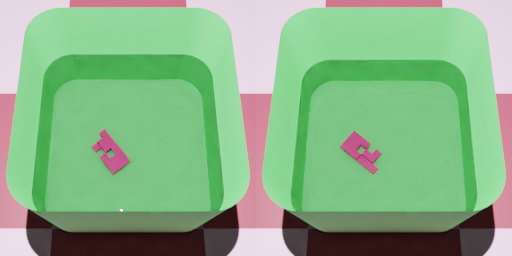

rotPred: 0.6556919376042227
rotTrue: 0.8886433262691122
dims: 5.4134912x2.9680648
 6.0x3.0

56-411    Pred             True          Loss = 0.49319053
x-y: -0.071327835x-0.08121948
-0.0521372353919417x-0.0928559014233569
Water height: 0.2542897087897655, comp: -0.090905405339181


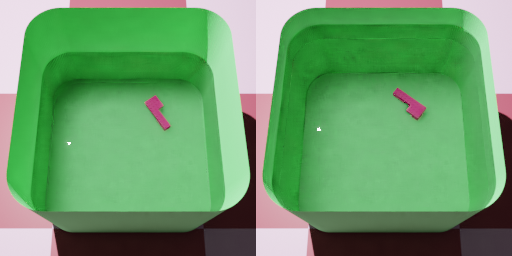

rotPred: 0.5994711677220206
rotTrue: 0.9132354366662154
dims: 5.0269823x1.6838219
 5.0x2.0

55-391    Pred             True          Loss = 0.49325383
x-y: 0.08192025x-0.053132527
0.0840576465901042x-0.0517488202851293
Water height: 0.2389517357123665, comp: -0.0778572042954734


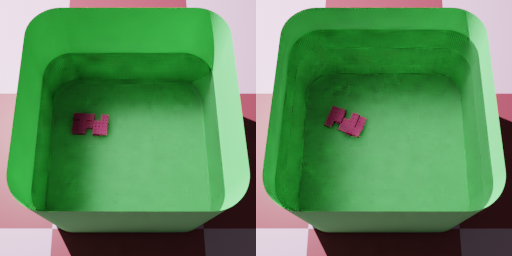

rotPred: 1.500320435562406
rotTrue: 1.2262733619180715
dims: 5.457499x2.8686485
 5.0x3.0

54-509    Pred             True          Loss = 0.49666047
x-y: 0.011321528x-0.05359058
0.0242508331294837x-0.0647268632430972
Water height: 0.0470954963372358, comp: 0.117102827747046


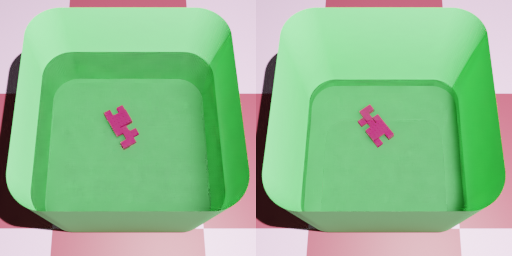

rotPred: 0.49381478230026765
rotTrue: 0.6385373652991437
dims: 5.5498376x3.2409005
 6.0x3.0

53-558    Pred             True          Loss = 0.5222037
x-y: 0.08338147x-0.02043901
0.0825705132424462x-0.0175692884526699
Water height: 0.2277369076796778, comp: -0.0661158139296778


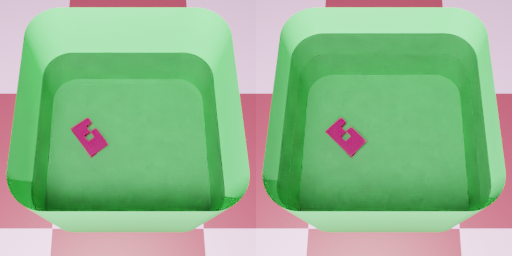

rotPred: 0.6342501203205924
rotTrue: 0.8013691011169071
dims: 5.544024x2.9806952
 5.0x3.0

52-75    Pred             True          Loss = 0.53030205
x-y: -0.007222073x0.014568725
-0.013316584121584x0.0162077085159619
Water height: 0.1319903429100497, comp: 0.0284518007686153


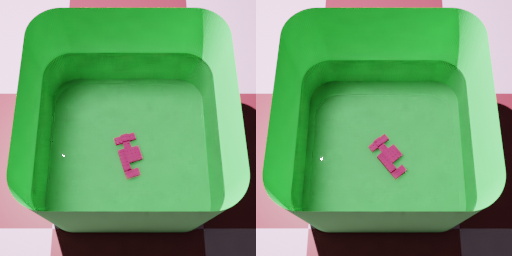

rotPred: 0.3057912151005606
rotTrue: 0.6882512538675734
dims: 5.8499765x3.3160396
 6.0x3.0

51-365    Pred             True          Loss = 0.5316154
x-y: -0.0074175876x0.02529414
-0.0083444681249893x0.0118188836924213
Water height: 0.0545189585122656, comp: 0.1052956823673653


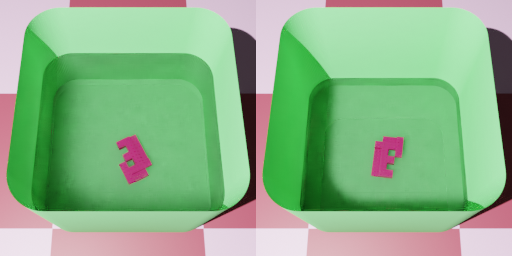

rotPred: 0.45678313175705476
rotTrue: 1.454295565533145
dims: 5.88023x3.7997184
 6.0x4.0

50-224    Pred             True          Loss = 0.5324106
x-y: -0.082835615x-0.004935571
-0.0851522121475095x-0.0125509995606892
Water height: 0.0434928306423005, comp: 0.1160876682914915


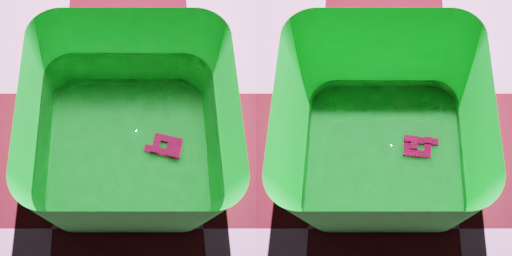

rotPred: 1.323725582161222
rotTrue: 1.4822971148306836
dims: 5.5531435x2.853382
 5.0x3.0

49-996    Pred             True          Loss = 0.5375717
x-y: -0.005199979x-0.0071207797
-0.0010886647992051x-0.0029647708687027
Water height: 0.2754804237304827, comp: -0.1103409721075198


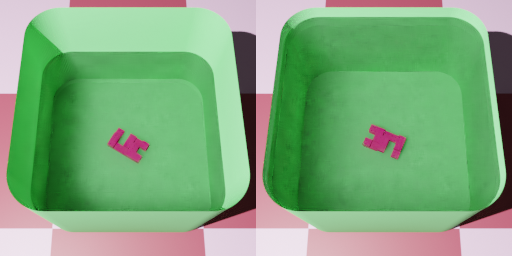

rotPred: 1.0220531384137015
rotTrue: 1.1750898327465462
dims: 5.4227734x3.39286
 5.0x3.0

48-355    Pred             True          Loss = 0.5381813
x-y: 0.089108475x-0.035283267
0.0951824626688037x-0.0417734259191723
Water height: 0.1979711426343983, comp: -0.0362518800344532


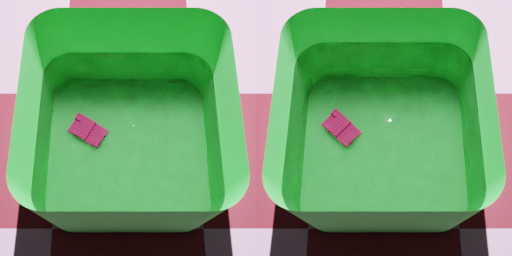

rotPred: 1.040227131047521
rotTrue: 0.8327071536274193
dims: 5.4529533x2.5265455
 5.0x3.0

47-594    Pred             True          Loss = 0.54351616
x-y: -0.003079364x0.007147773
0.0030953838482696x0.0039211050904224
Water height: 0.1097131456851748, comp: 0.0523726705789776


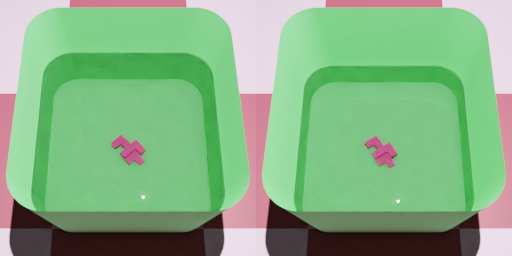

rotPred: 0.7148354212429862
rotTrue: 0.5665420173614937
dims: 5.086014x2.5798867
 5.0x3.0

46-769    Pred             True          Loss = 0.54505175
x-y: -0.058507524x0.03526866
-0.0654138428089122x0.0299451082920591
Water height: 0.2679131133143778, comp: -0.103249887902009


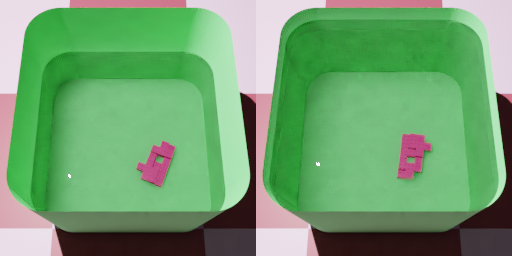

rotPred: 1.2018247842788696
rotTrue: 1.4351564362098967
dims: 5.5117865x3.821817
 6.0x4.0

45-271    Pred             True          Loss = 0.5451374
x-y: -0.0024361927x0.03641301
0.0051875793871532x0.0290451067923104
Water height: 0.1763007508652896, comp: -0.0148628817933292


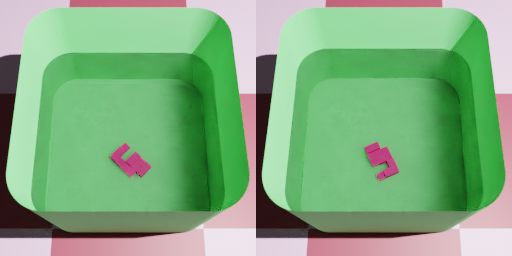

rotPred: 0.79118009010819
rotTrue: 0.4185422728964887
dims: 5.0521555x2.410881
 5.0x3.0

44-78    Pred             True          Loss = 0.54609185
x-y: -0.042940937x0.01823835
-0.0475856683009345x0.0206575900679818
Water height: 0.0560893949483056, comp: 0.1095082822825293


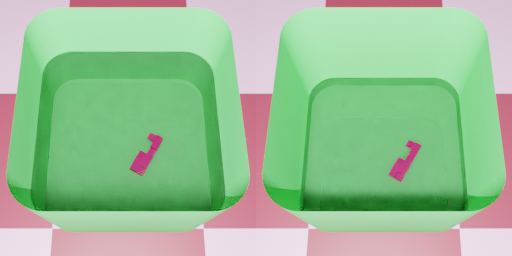

rotPred: 1.061103582382202
rotTrue: 1.0467685138170548
dims: 5.6373253x1.4969715
 6.0x2.0

43-478    Pred             True          Loss = 0.5463647
x-y: -0.07945931x-0.03186409
-0.0815744106160428x-0.0313983974505371
Water height: 0.1390061345958194, comp: 0.022079754147581


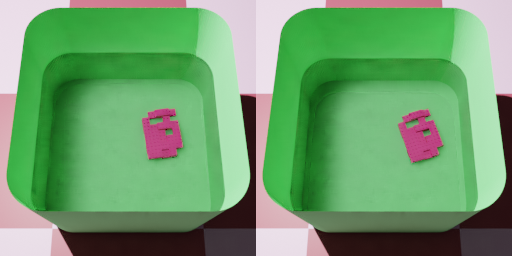

rotPred: 0.1330140391972403
rotTrue: 0.3038366309741436
dims: 7.2804995x5.3649955
 7.0x5.0

42-548    Pred             True          Loss = 0.5507312
x-y: 0.03536059x0.08508101
0.0298457998780651x0.080846191568993
Water height: 0.2221094321481725, comp: -0.0584862183801672


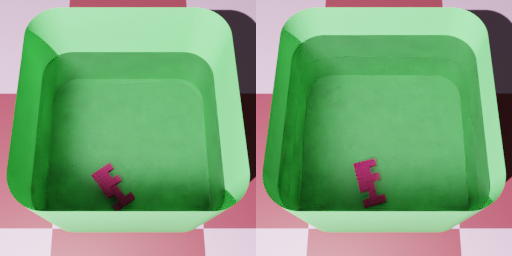

rotPred: 0.619109527268682
rotTrue: 0.2700792973598958
dims: 5.5985546x2.7174144
 6.0x3.0

41-919    Pred             True          Loss = 0.552753
x-y: -0.09119533x-0.007580542
-0.0962734943457412x-0.022275417037558
Water height: 0.1121102793290764, comp: 0.0495307670757621


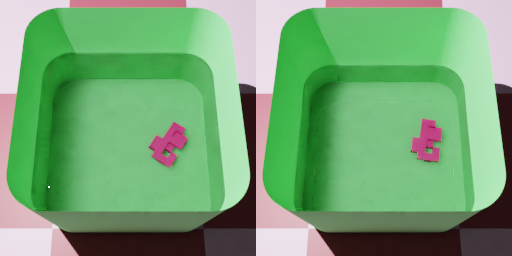

rotPred: 0.9950522184371948
rotTrue: 1.4083594351084128
dims: 5.752857x3.6684098
 6.0x4.0

40-811    Pred             True          Loss = 0.5582442
x-y: 0.08380136x-0.031984765
0.0882321207355827x-0.0163531231625044
Water height: 0.2279696032360419, comp: -0.0688398197248801


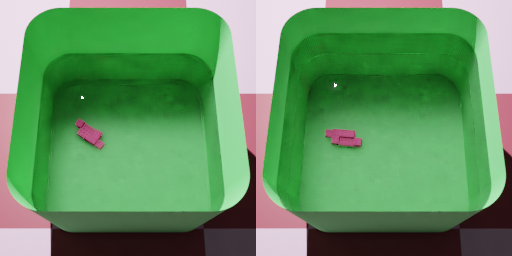

rotPred: 1.0010184804585318
rotTrue: 1.4884501837204653
dims: 5.206889x2.1396089
 5.0x2.0

39-762    Pred             True          Loss = 0.5593625
x-y: -0.013927108x-0.0037416518
-0.0141391029067537x-0.0008505306531054
Water height: 0.1902383530355992, comp: -0.0259492659784855


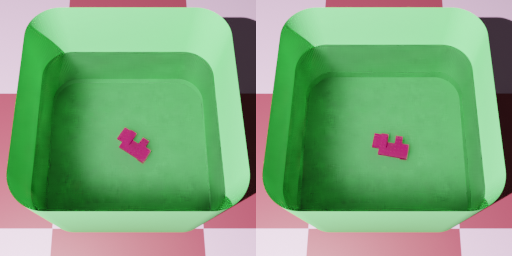

rotPred: 0.9831659356739859
rotTrue: 1.3966907406409392
dims: 5.2606173x2.770903
 5.0x3.0

38-281    Pred             True          Loss = 0.55984616
x-y: 0.07581978x-0.013169576
0.0667092996635207x-0.0158779872809285
Water height: 0.1364993640853694, comp: 0.0198178699539372


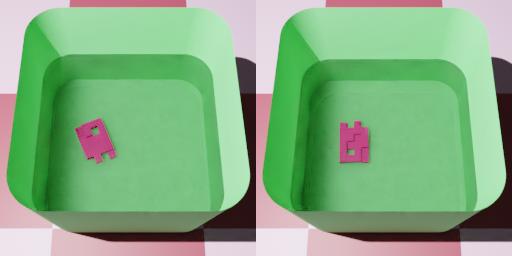

rotPred: 0.39449341694382234
rotTrue: 0.041308357916351124
dims: 5.8768263x3.5766416
 6.0x4.0

37-552    Pred             True          Loss = 0.56095856
x-y: -0.043633975x0.07285164
-0.0364584556725205x0.076000947024149
Water height: 0.1700923910641059, comp: -0.0050812831425056


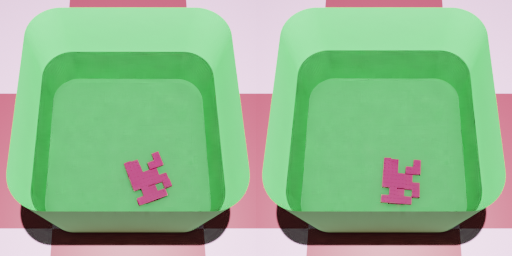

rotPred: 0.3453696529057364
rotTrue: 1.4942178714160308
dims: 6.388194x4.7133203
 6.0x5.0

36-661    Pred             True          Loss = 0.5669393
x-y: -0.08328564x0.0057959957
-0.0954724707310992x-0.0038616741680628
Water height: 0.0781433869267334, comp: 0.0819873373841415


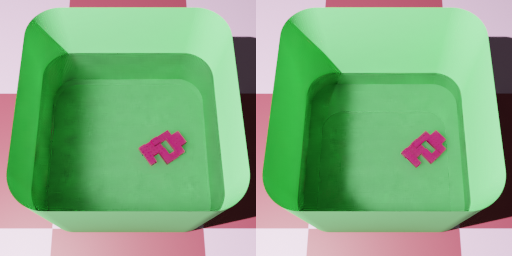

rotPred: 0.5888416767120361
rotTrue: 0.7500274962843285
dims: 6.011895x3.4394145
 6.0x4.0

35-699    Pred             True          Loss = 0.5679924
x-y: -0.07679481x0.027225357
-0.0774951509100612x0.0253921450374788
Water height: 0.2152611024428554, comp: -0.0568180240441509


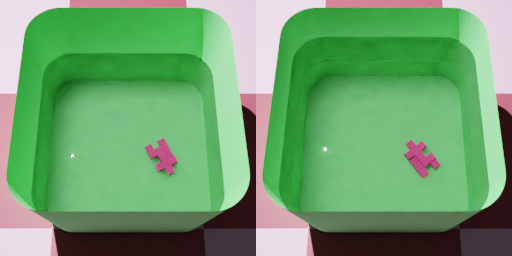

rotPred: 0.45548255840805574
rotTrue: 0.6465806097388573
dims: 5.51481x2.8780234
 5.0x3.0

34-660    Pred             True          Loss = 0.5689297
x-y: 0.016775481x-0.08180408
0.0206443915950044x-0.084525236352797
Water height: 0.2603173518749282, comp: -0.1000273788543746


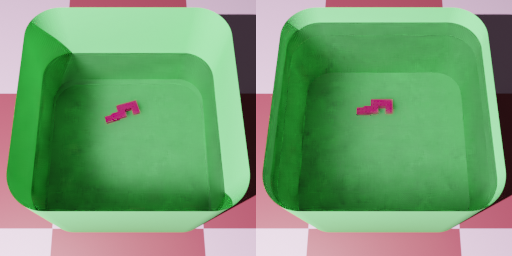

rotPred: 0.2893845736980438
rotTrue: 0.0067126156686461
dims: 4.64606x1.5999949
 5.0x2.0

33-931    Pred             True          Loss = 0.5764553
x-y: 0.09025578x-0.05801933
0.0795468878903998x-0.0528485592056433
Water height: 0.0757158673115044, comp: 0.0851238393478125


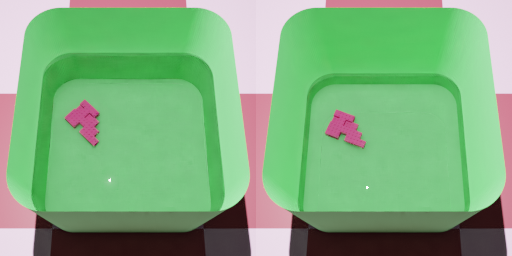

rotPred: 0.8033118406918387
rotTrue: 1.1964368255885596
dims: 5.7799435x3.7260866
 6.0x4.0

32-431    Pred             True          Loss = 0.5832711
x-y: 0.08380787x-0.010344878
0.0856696774191315x-0.0167907843273791
Water height: 0.2196570036928622, comp: -0.0599439291279285


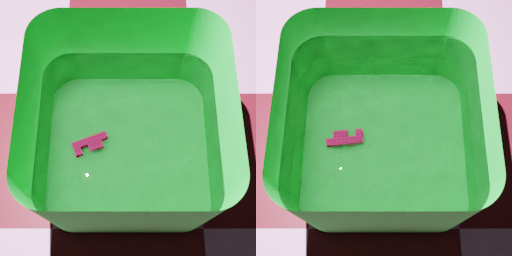

rotPred: 0.3724022507667541
rotTrue: 0.10528239798941996
dims: 4.8693905x2.3791728
 5.0x2.0

31-272    Pred             True          Loss = 0.58712614
x-y: -0.03043236x0.049689855
-0.033834512050473x0.0483316248349522
Water height: 0.223322633604517, comp: -0.0624687559409047


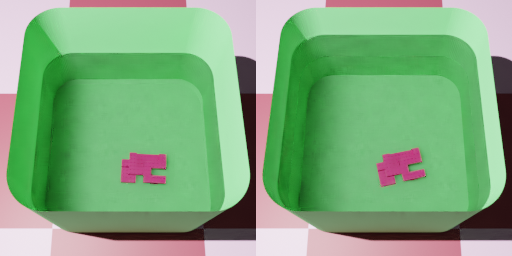

rotPred: 1.5162250521269183
rotTrue: 0.2069463648901844
dims: 5.596076x3.6043396
 6.0x4.0

30-408    Pred             True          Loss = 0.5895783
x-y: -0.023030972x-0.046656813
-0.0280135148374459x-0.0418765266803451
Water height: 0.2492974258383129, comp: -0.0855000323971127


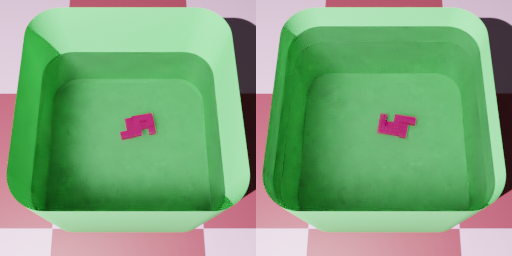

rotPred: 0.1870503574609756
rotTrue: 1.4110416587394727
dims: 5.261236x2.538249
 5.0x3.0

29-678    Pred             True          Loss = 0.59179777
x-y: 0.0046174084x-0.036708906
0.0027422738119293x-0.0278227981412479
Water height: 0.2578599879687869, comp: -0.094973770732268


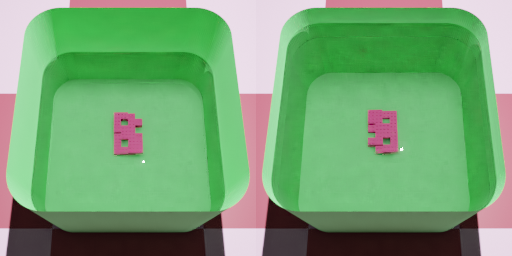

rotPred: 0.007991151013646558
rotTrue: 0.017858187418076987
dims: 5.622707x3.3778453
 6.0x4.0

28-964    Pred             True          Loss = 0.5957454
x-y: 0.083278395x0.070001446
0.0817435603681272x0.0918217140441051
Water height: 0.1519385466493679, comp: 0.0040420552574085


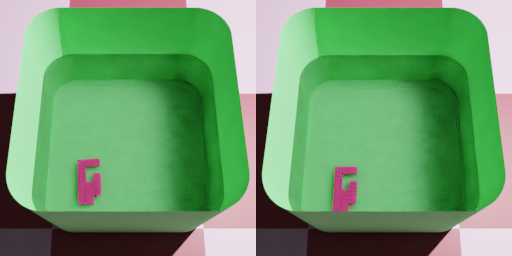

rotPred: 0.06366975704697175
rotTrue: 1.5650169334093293
dims: 5.3068094x2.9014502
 6.0x3.0

27-693    Pred             True          Loss = 0.59823775
x-y: -0.0042873714x0.016484216
0.0025179807314251x0.0142229576052444
Water height: 0.0564810880305132, comp: 0.1062232158301511


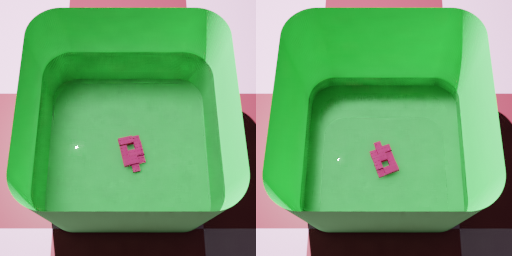

rotPred: 0.23610647121933503
rotTrue: 0.35754091093296814
dims: 5.0716877x2.2452707
 5.0x3.0

26-328    Pred             True          Loss = 0.60521436
x-y: 0.06869336x-0.07073444
0.0681402633678232x-0.0648691357113627
Water height: 0.2615266564784934, comp: -0.0999939266143729


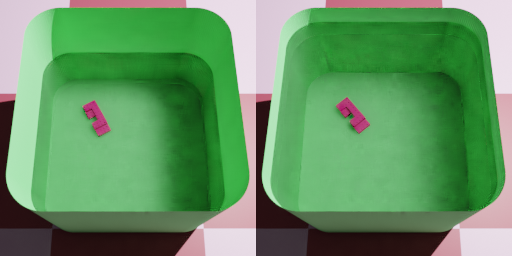

rotPred: 0.5033015767720084
rotTrue: 0.704076935173541
dims: 5.078659x2.3415933
 5.0x2.0

25-154    Pred             True          Loss = 0.60610616
x-y: 0.07197614x-0.06835482
0.0649296678358266x-0.062220883594024
Water height: 0.2354323274146274, comp: -0.0758230990420536


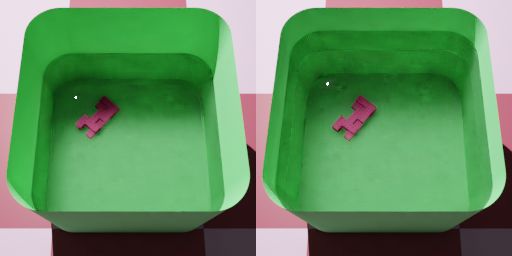

rotPred: 0.8330886363983154
rotTrue: 0.9024136936226078
dims: 5.338269x2.8068962
 6.0x3.0

24-609    Pred             True          Loss = 0.618292
x-y: -0.07527679x0.00090695824
-0.0859942125009411x-0.0152444737761965
Water height: 0.0653944160047771, comp: 0.0982804004844425


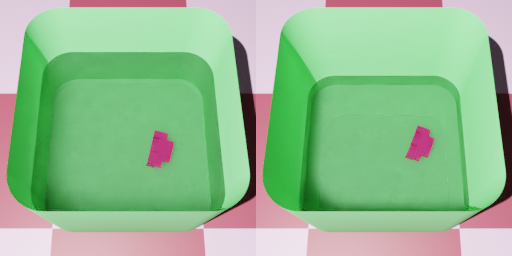

rotPred: 1.330100655555725
rotTrue: 1.197894746184654
dims: 5.6996284x2.9289155
 5.0x3.0

23-662    Pred             True          Loss = 0.62125826
x-y: -0.068122275x-0.068811014
-0.0822700167627635x-0.0874625177871294
Water height: 0.0514474217970022, comp: 0.1091778273504129


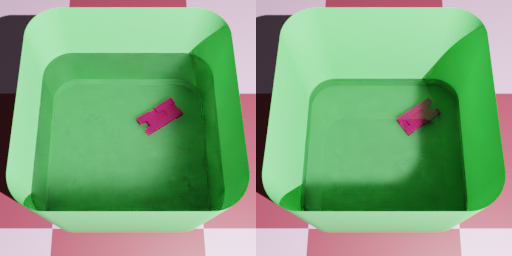

rotPred: 0.5849848389625549
rotTrue: 0.6167230979202039
dims: 5.235759x2.8268428
 6.0x3.0

22-445    Pred             True          Loss = 0.63112104
x-y: -0.049458228x0.06867157
-0.054576735193012x0.0693522782622676
Water height: 0.2626726256534898, comp: -0.1015237646028841


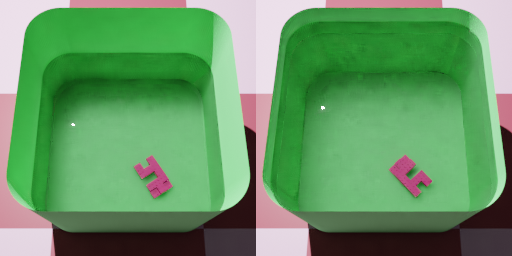

rotPred: 0.5709373513844351
rotTrue: 0.7422256258297915
dims: 5.0660496x2.289094
 5.0x3.0

21-467    Pred             True          Loss = 0.63674045
x-y: -0.071181014x-0.06528902
-0.0761028294414178x-0.0637534228204457
Water height: 0.0737073286308267, comp: 0.0848342911468526


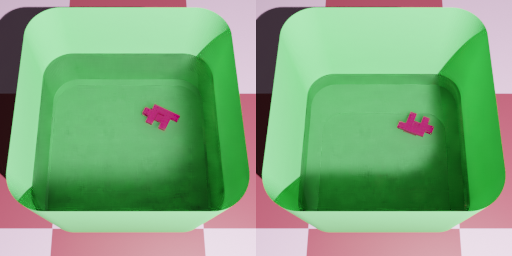

rotPred: 1.093698308863912
rotTrue: 1.1906614312564598
dims: 5.275552x2.3558168
 5.0x3.0

20-298    Pred             True          Loss = 0.6370586
x-y: 0.019250803x-0.058389343
0.0234683132522935x-0.0553270278285627
Water height: 0.1228388412438006, comp: 0.0408328609027295


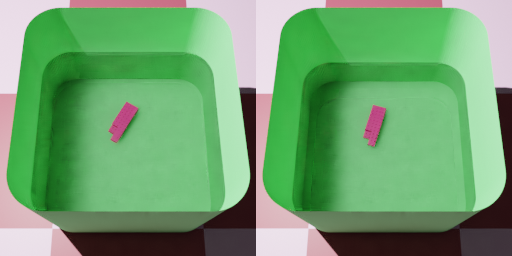

rotPred: 1.0308876037597656
rotTrue: 1.2914083229497588
dims: 5.606652x2.4782853
 6.0x2.0

19-227    Pred             True          Loss = 0.6428694
x-y: -0.010185922x0.079581484
-0.0121031366837812x0.081394693951774
Water height: 0.2614875040785824, comp: -0.0992589197890317


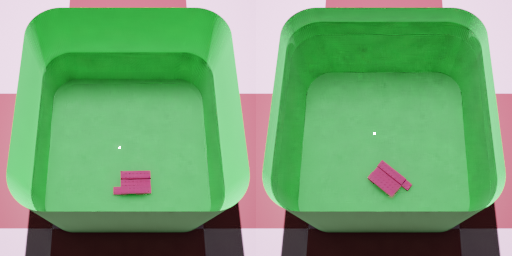

rotPred: 0.0195579789578914
rotTrue: 0.8915057459561906
dims: 5.2191734x2.8465645
 5.0x3.0

18-971    Pred             True          Loss = 0.64429945
x-y: -0.083908744x0.06529255
-0.0822397882793138x0.0524106953185208
Water height: 0.056766176101177, comp: 0.1059117080006906


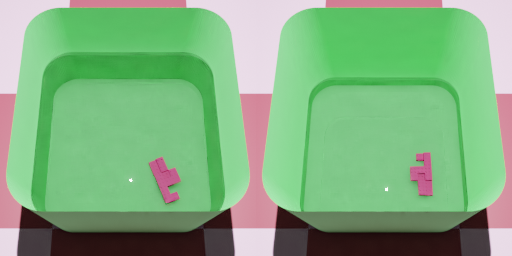

rotPred: 0.36500080029037996
rotTrue: 0.018730562110669258
dims: 5.418483x3.1282883
 6.0x3.0

17-740    Pred             True          Loss = 0.6449148
x-y: 0.08186948x0.050502848
0.0776397677964179x0.0451112463923003
Water height: 0.0600227638681443, comp: 0.0937429145376173


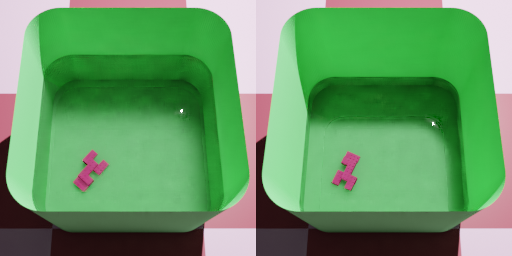

rotPred: 0.8596028089523315
rotTrue: 1.1473916324551698
dims: 5.4237566x2.646688
 5.0x3.0

16-334    Pred             True          Loss = 0.6525028
x-y: 0.007882444x0.08124548
0.0099922054447995x0.0880386221508571
Water height: 0.2552906279748592, comp: -0.0896510635799083


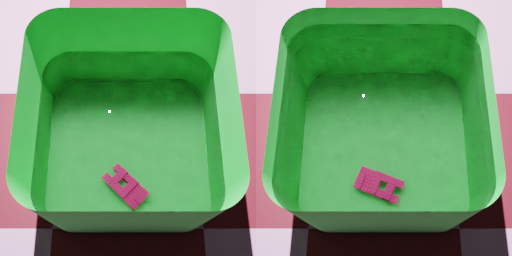

rotPred: 0.7889866391804556
rotTrue: 1.1965667698143183
dims: 5.3449893x3.1472454
 6.0x3.0

15-855    Pred             True          Loss = 0.65342987
x-y: -0.028017284x-0.034116905
-0.0313024324863685x-0.0378181724424763
Water height: 0.1315440518104587, comp: 0.0325663554227795


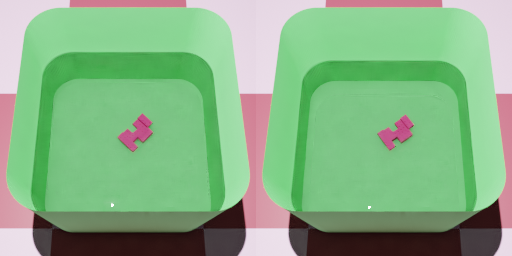

rotPred: 0.7935992479324341
rotTrue: 0.6192199837863442
dims: 5.543146x2.4368947
 5.0x3.0

14-57    Pred             True          Loss = 0.6561384
x-y: 0.045686826x0.08120873
0.0547636086463505x0.0841730721834373
Water height: 0.2341482605078482, comp: -0.0716738517620826


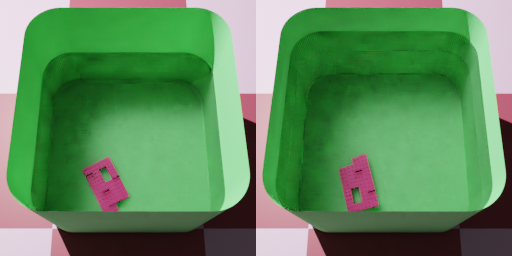

rotPred: 0.48314721981552666
rotTrue: 0.2560093898490914
dims: 6.320549x4.0774817
 7.0x4.0

13-904    Pred             True          Loss = 0.65686655
x-y: 0.006825113x-0.08139481
0.000458961243726x-0.0851583601481079
Water height: 0.1386187077620294, comp: 0.0226777045867178


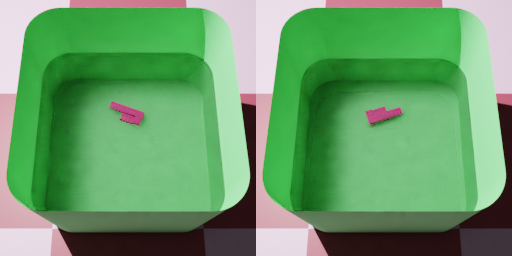

rotPred: 1.209500060477529
rotTrue: 0.33160412828169905
dims: 4.856365x2.0179992
 5.0x2.0

12-962    Pred             True          Loss = 0.6582246
x-y: -0.020961458x-0.031017903
-0.0209026651468393x-0.0339990134737876
Water height: 0.2323252975496033, comp: -0.0680979907067994


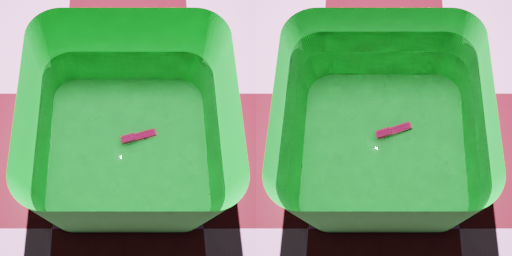

rotPred: 0.2783589661121368
rotTrue: 0.3282752953170273
dims: 4.8039675x1.5402571
 5.0x1.0

11-312    Pred             True          Loss = 0.66424775
x-y: 0.08018198x-0.043579374
0.0772105771512722x-0.0487554350529546
Water height: 0.1714151409416417, comp: -0.0075997021942356


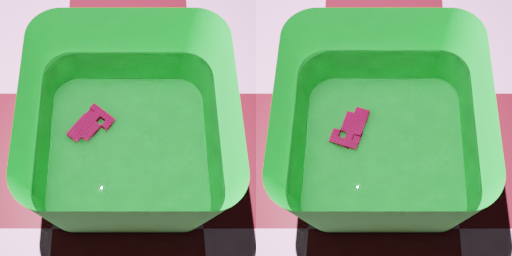

rotPred: 0.8962889909744263
rotTrue: 1.2731512659578668
dims: 5.8221235x3.404975
 6.0x4.0

10-498    Pred             True          Loss = 0.6654574
x-y: 0.004866619x-0.075053215
0.0086538139709857x-0.0721422885115521
Water height: 0.0935605937261627, comp: 0.0704276984910919


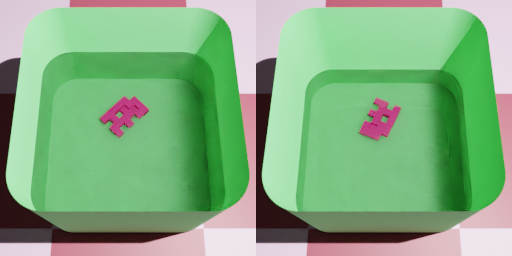

rotPred: 0.7825178503990173
rotTrue: 1.1526361824280311
dims: 6.0046396x3.4244604
 6.0x4.0

9-686    Pred             True          Loss = 0.6680552
x-y: 0.0040987134x0.081589736
0.0096684795993116x0.0968231142335691
Water height: 0.1494581859981134, comp: 0.0120790589178488


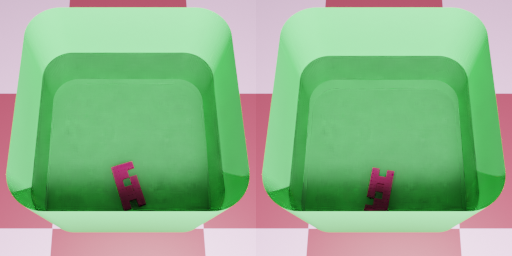

rotPred: 0.3055260936405997
rotTrue: 1.389880049549994
dims: 5.4455047x2.5836768
 6.0x3.0

8-795    Pred             True          Loss = 0.6700593
x-y: 0.009117458x-0.09280148
0.0005241499300659x-0.0901693514278474
Water height: 0.119646725434804, comp: 0.0411495890431165


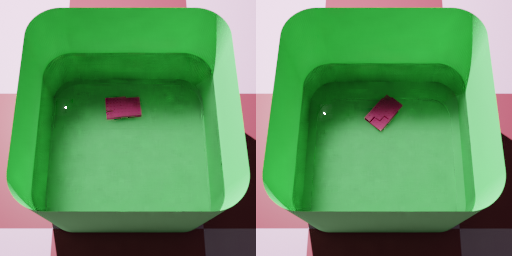

rotPred: 0.0865528732538223
rotTrue: 0.8835493007284363
dims: 5.1888123x2.4732132
 5.0x3.0

7-551    Pred             True          Loss = 0.67162156
x-y: -0.024387447x0.050400864
-0.028153734813123x0.0494807617757896
Water height: 0.1278581251728014, comp: 0.0340766827238125


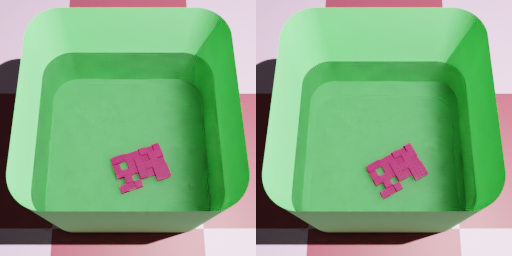

rotPred: 0.3298741281032562
rotTrue: 0.5075424580583318
dims: 6.470481x4.577838
 7.0x5.0

6-523    Pred             True          Loss = 0.6759583
x-y: -0.01238176x-0.00035886746
-0.0106781718850835x0.0070305408596493
Water height: 0.067492553996679, comp: 0.0945519562486441


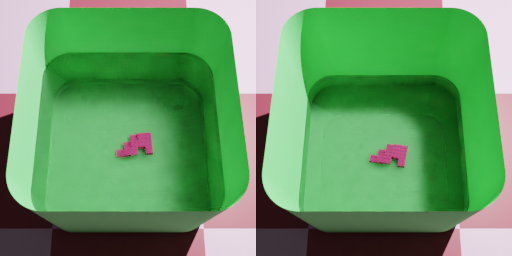

rotPred: 0.0832914859056472
rotTrue: 1.3911831821193115
dims: 4.859973x2.2658648
 5.0x3.0

5-563    Pred             True          Loss = 0.68575245
x-y: 0.051991716x-0.092572816
0.057396890186185x-0.0893558003845779
Water height: 0.1600705337200845, comp: 0.0045310008849416


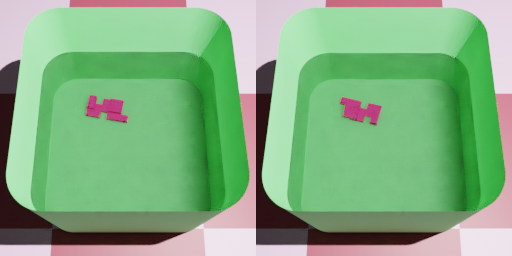

rotPred: 1.38590265909699
rotTrue: 1.3274307612830487
dims: 5.1772413x2.7871046
 6.0x3.0

4-920    Pred             True          Loss = 0.6894445
x-y: -0.017958941x-0.012916821
-0.016421371858949x-0.0159833024500897
Water height: 0.0569889151450329, comp: 0.1063568986061878


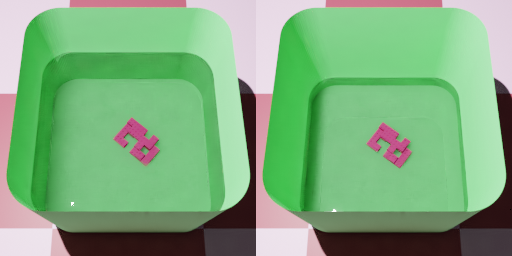

rotPred: 0.8597500483181815
rotTrue: 0.9273446860083592
dims: 5.5756426x3.395173
 6.0x4.0

3-944    Pred             True          Loss = 0.6903908
x-y: -0.006204458x-0.08281441
0.0002230265937298x-0.0964883034235062
Water height: 0.194307038287931, comp: -0.0284143627689414


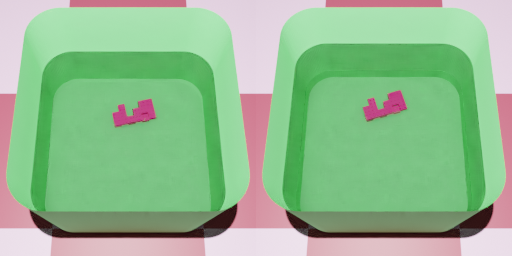

rotPred: 0.2086437791585922
rotTrue: 0.301079533218426
dims: 5.262298x3.2116714
 6.0x3.0

2-242    Pred             True          Loss = 0.71956515
x-y: 0.08224213x-0.025581352
0.0806840736539362x-0.0200314057212285
Water height: 0.2008699945793618, comp: -0.0401995949135293


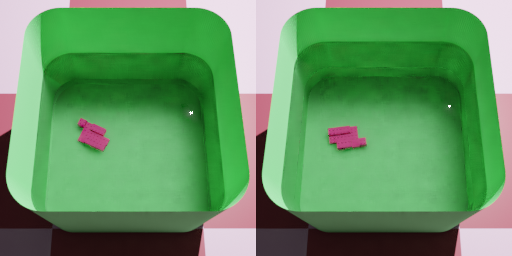

rotPred: 1.136633918681417
rotTrue: 0.143174536194012
dims: 5.0298505x2.4696898
 5.0x3.0

1-332    Pred             True          Loss = 0.72101176
x-y: 0.011511565x-0.07494321
0.0054086899808371x-0.0834497013981407
Water height: 0.2282674488706629, comp: -0.0654076513929407


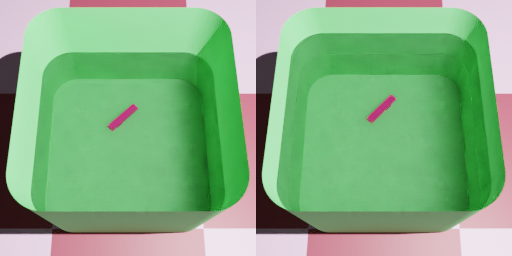

rotPred: 0.7468643188476562
rotTrue: 0.8095390662164599
dims: 5.3287168x1.3682892
 5.0x1.0


In [167]:
n = 100
for idx in loss_df.head(n).index:

#     idx = -2
    img_pred = Image.open(f'{picture_folder}PredictionsShapeCorrections\\image_{idx}_Pred.png').convert('RGB')
    img_true = Image.open(f'{picture_folder}PredictionsShapeCorrections\\image_{idx}_True.png').convert('RGB')
#     img_pred = Image.open(f'{picture_folder}Predictions\\image_{idx+2}_Pred.png').convert('RGB')
#     img_true = Image.open(f'{picture_folder}Predictions\\image_{idx+2}_True.png').convert('RGB')
    
    new_size = (256, 256)
    
    img_pred = img_pred.resize(new_size)
    img_true = img_true.resize(new_size)
    
    im_combined = Image.new('RGB', (img_pred.width + img_true.width, img_true.height))
    im_combined.paste(img_pred, (0, 0))
    im_combined.paste(img_true, (img_pred.width, 0))
    
    print(f"\n{n}-{idx}    Pred             True          Loss = {dfComp['Losses'][idx]}")
    print(f"x-y: {dfComp.iloc[idx]['LegoXPred']}x{dfComp.iloc[idx]['LegoYPred']}\n{dfComp.iloc[idx]['LegoXTrue']}x{dfComp.iloc[idx]['LegoYTrue']}")
    print(f"Water height: {dfComp.iloc[idx]['WaterHeightTrue']}, comp: {dfComp.iloc[idx]['WaterHeightComp']}")
    display(im_combined)
    im_combined.save(f'{picture_folder}PredSCCompared\\image_{idx}_Best.jpg')
    print(f"rotPred: {dfComp.iloc[idx]['LegoRotPred']%(math.pi/2)}\nrotTrue: {dfComp.iloc[idx]['LegoRotTrue']%(math.pi/2)}")
    print(f"dims: {dfComp.iloc[idx]['lego_length_Pred']}x{dfComp.iloc[idx]['lego_width_Pred']}\n {dfComp.iloc[idx]['lego_length_True']}x{dfComp.iloc[idx]['lego_width_True']}")
    
    
    n -= 1


0    Actual           Pred             True


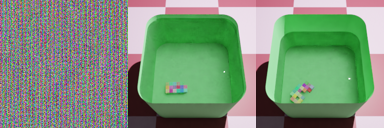

   7x4x2           5x2x2     


1    Actual           Pred             True


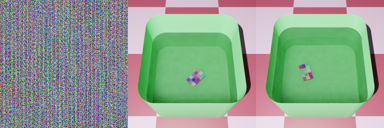

   5x3x2           4x3x2     


2    Actual           Pred             True


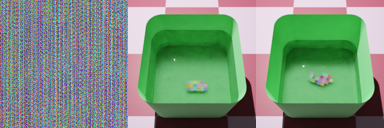

   7x4x2           5x2x1     


3    Actual           Pred             True


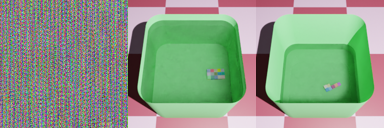

   5x2x2           4x2x1     


4    Actual           Pred             True


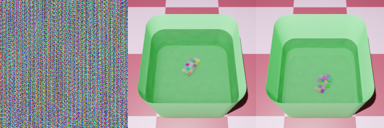

   6x4x2           4x3x1     


5    Actual           Pred             True


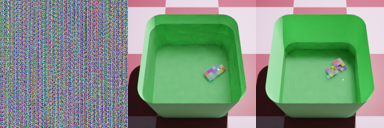

   7x4x3           5x3x1     


6    Actual           Pred             True


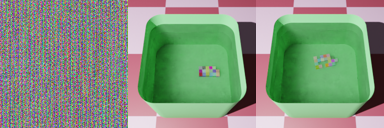

   7x4x1           5x3x1     


7    Actual           Pred             True


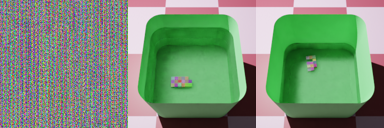

   5x3x3           4x2x1     


8    Actual           Pred             True


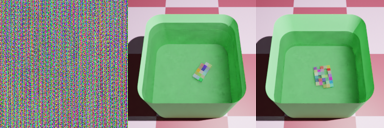

   7x5x2           5x4x2     


9    Actual           Pred             True


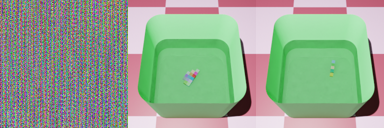

   5x1x3           4x1x1     


10    Actual           Pred             True


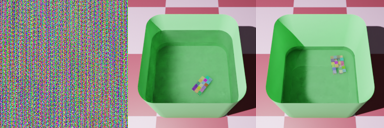

   6x4x3           4x3x1     


11    Actual           Pred             True


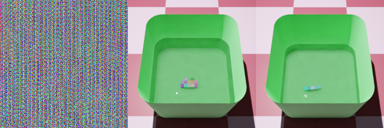

   5x1x2           4x0x1     


12    Actual           Pred             True


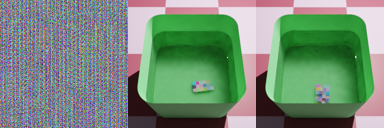

   6x4x3           4x2x1     


13    Actual           Pred             True


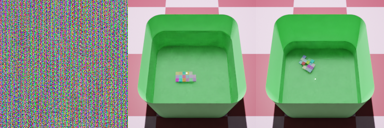

   5x4x2           4x3x1     


14    Actual           Pred             True


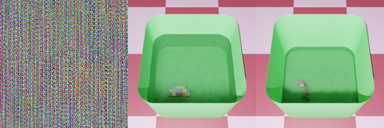

   6x3x2           5x2x1     


15    Actual           Pred             True


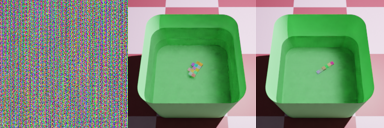

   6x1x2           4x0x1     


16    Actual           Pred             True


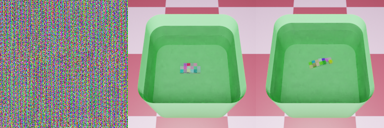

   7x2x3           5x2x2     


17    Actual           Pred             True


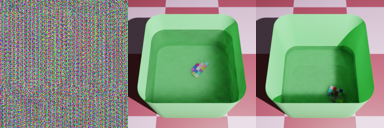

   6x5x3           4x1x1     


18    Actual           Pred             True


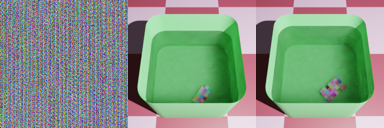

   7x4x3           5x4x2     


19    Actual           Pred             True


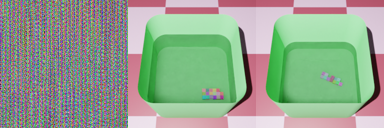

   7x2x2           5x2x1     


20    Actual           Pred             True


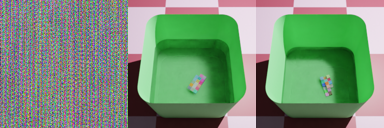

   6x3x3           5x2x1     


21    Actual           Pred             True


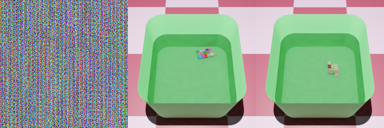

   5x3x1           4x1x2     


22    Actual           Pred             True


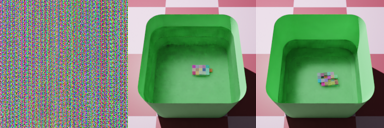

   6x4x3           4x3x1     


23    Actual           Pred             True


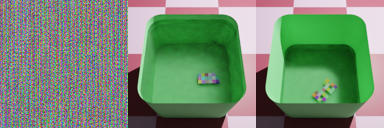

   7x4x1           5x3x2     


24    Actual           Pred             True


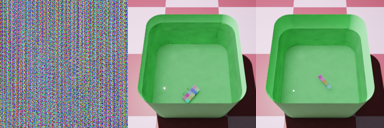

   5x1x3           4x0x1     


25    Actual           Pred             True


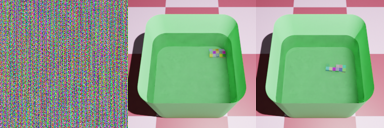

   6x2x3           4x1x1     


26    Actual           Pred             True


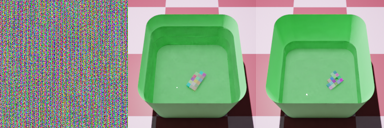

   5x4x1           4x2x1     


27    Actual           Pred             True


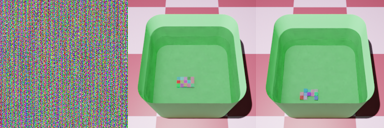

   5x3x3           4x1x1     


28    Actual           Pred             True


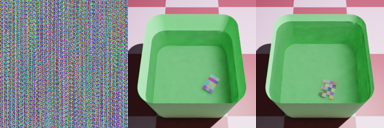

   5x4x2           3x3x1     


29    Actual           Pred             True


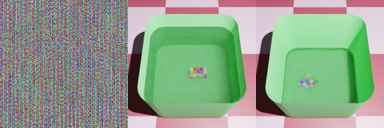

   5x4x2           4x2x2     


30    Actual           Pred             True


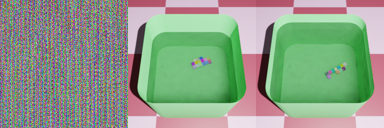

   7x2x2           5x1x2     


31    Actual           Pred             True


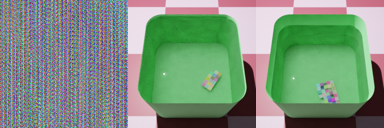

   7x5x3           5x4x2     


32    Actual           Pred             True


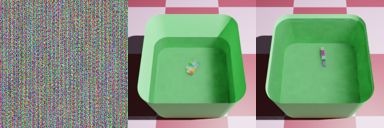

   6x1x3           4x1x1     


33    Actual           Pred             True


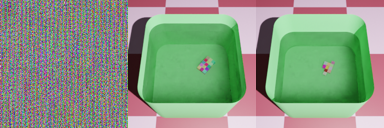

   5x3x2           4x2x1     


34    Actual           Pred             True


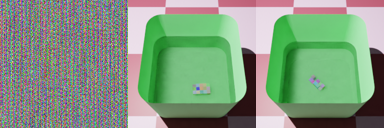

   5x2x3           4x1x1     


35    Actual           Pred             True


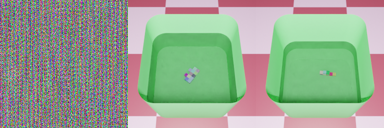

   5x1x3           4x1x2     


36    Actual           Pred             True


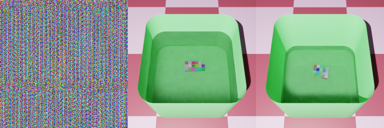

   5x4x2           4x2x1     


37    Actual           Pred             True


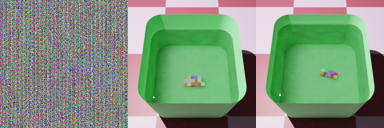

   5x2x3           4x2x1     


38    Actual           Pred             True


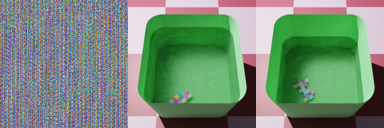

   7x5x1           5x2x1     


39    Actual           Pred             True


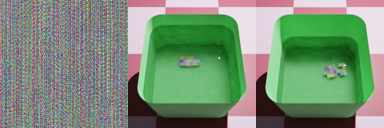

   7x4x2           5x4x2     


40    Actual           Pred             True


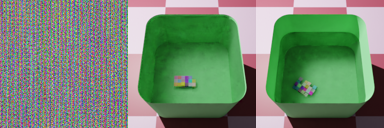

   6x4x2           4x3x1     


41    Actual           Pred             True


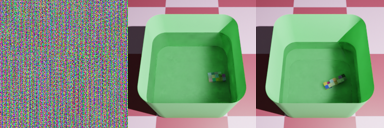

   7x2x3           4x1x2     


42    Actual           Pred             True


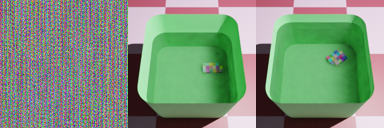

   5x4x3           4x3x1     


43    Actual           Pred             True


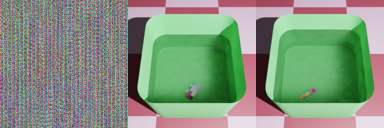

   5x1x2           4x1x1     


44    Actual           Pred             True


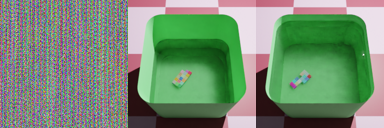

   6x3x1           4x2x1     


45    Actual           Pred             True


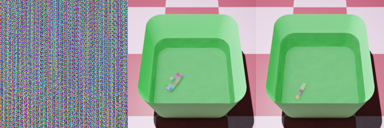

   5x1x1           5x1x1     


46    Actual           Pred             True


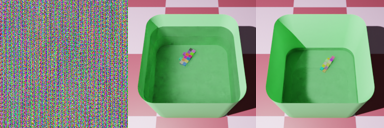

   6x2x3           5x1x2     


47    Actual           Pred             True


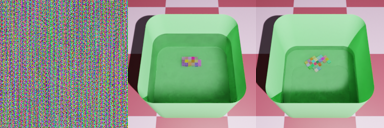

   7x5x1           5x3x1     


48    Actual           Pred             True


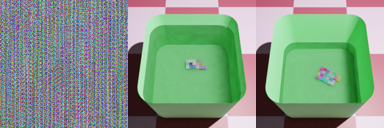

   7x4x2           5x3x2     


49    Actual           Pred             True


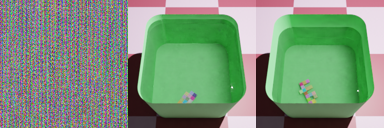

   7x4x1           4x3x1     



In [96]:
for i in range(50):
    img_actual = Image.open(f'{picture_folder}Predictions\\image_{i}_Actual.jpg').convert('RGB')
    img_pred = Image.open(f'{picture_folder}Predictions\\image_{i}_Pred.png').convert('RGB')
    img_true = Image.open(f'{picture_folder}Predictions\\image_{i}_True.png').convert('RGB')
    
    new_size = (128, 128)
    
    # Resize the image
    img_actual = img_actual.resize(new_size)
    img_pred = img_pred.resize(new_size)
    img_true = img_true.resize(new_size)
    
    im_combined = Image.new('RGB', (img_actual.width + img_pred.width + img_true.width, img_true.height))
    im_combined.paste(img_actual, (0, 0))
    im_combined.paste(img_pred, (img_actual.width, 0))
    im_combined.paste(img_true, (img_actual.width + img_pred.width, 0))

    # Display the resized image
    print(f"\n{i}    Actual           Pred             True")
    display(im_combined)
    print(f"   {int(lego_length_True[i])}x{int(lego_width_True[i])}x{int(lego_height_True[i])}           {int(lego_length_Pred[i])}x{int(lego_width_Pred[i])}x{int(lego_height_Pred[i])}     \n")
    
    #display(img_actual.thumbnail((256, 256)))
    #display(img_pred)
    #display(img_true)
    

In [42]:
import ast

def deep_fish_loss2(t):
    "."
    name = t
    #alpha = 0.5 # just to make this code work for now
    def loss(y_true, y_pred):
        #print("y_true: ", y_true)
        #print("y_pred: ", y_pred)
        #print(name)
        l = 0
        if name == "position":
            l = squared_loss(y_true[:,:2], y_pred) * 100
        if name == "orientation":
            l = orientation_loss(y_true[:,2], y_pred)
        if name == "water":
            l = squared_loss(y_true[:,3], y_pred)
        if name == "xy_size":
            l = squared_loss(y_true[:,7:9], y_pred)
        if name == "z_size":
            l = squared_loss(y_true[:,9], y_pred)
        if name == "camera":
            l = squared_loss(y_true[:,10:13], y_pred)
        if name == "shape":
#             print(y_true)
            l = dice_coef_loss(y_true[:,13][0], y_pred)
        
        
        return l
    
    def orientation_loss(y_true, y_pred):
        y_true = np.asarray(y_true).astype('float32')
        y_pred = np.asarray(y_pred).astype('float32')
        
        y_true_f = backend.flatten(y_true)
        true_x = 1*backend.sin(y_true_f)
        true_y = 1*backend.cos(y_true_f)
        
        y_pred_f = backend.flatten(y_pred)
        pred_x = 1*backend.sin(y_pred_f)
        pred_y = 1*backend.cos(y_pred_f)
        
        dot_product = true_x * pred_x + true_y * pred_y
        
        return 1-backend.mean(backend.abs(dot_product))
        
        #diff = 3.1415927 - backend.abs(backend.abs(y_true_f - y_pred_f)-3.1415927)
        #print(backend.mean(backend.abs(diff)), "<-")
        #print(y_pred_f)
        #return backend.mean(backend.abs(diff))

    def dice_coef_loss(y_true, y_pred):
        y_true = ast.literal_eval(y_true)
        y_pred = ast.literal_eval(y_pred)
        return 1-dice_coef(y_true, y_pred)
    
    def dice_coef(y_true, y_pred):  
        #print(y_true)
        y_true = np.asarray(y_true).astype('float32')
        y_pred = np.asarray(y_pred).astype('float32')
        y_true_f = backend.flatten(y_true)
        y_pred_f = backend.flatten(y_pred)
        #print("---------------->", y_true_f)
        #print("---------------->", y_pred_f)
        #y_pred_f = tf.where(y_pred_f < 0.5, 0., 1.)
        #y_pred_f = backend.sigmoid(y_pred_f)
        
        
        intersection = backend.sum(y_true_f * y_pred_f)
        dice = (2. * intersection + 0.00001) / (backend.sum(y_true_f) + backend.sum(y_pred_f) + 0.00001)
        #print(np.shape(dice), "<---------------------------")
        return dice

        
    
    def squared_loss(y_true, y_pred):
        y_true = np.asarray(y_true).astype('float32')
        y_pred = np.asarray(y_pred).astype('float32')
        
        n_iter = 1
        losses = None
        y_pred = tf.convert_to_tensor(y_pred)
        y_true = tf.cast(y_true, y_pred.dtype)

        #losses = backend.mean(tf.math.squared_difference(y_pred, y_true), axis=-1)
        losses = tf.keras.losses.mean_squared_error(y_true, y_pred)
        
        #losses = np.square(np.subtract(y_true,y_pred)).mean()
        return losses/n_iter
        #return losses
        
    return loss

dfTrue = dfTrue[[c for c in dfTrue if c not in ['TrueShape']] 
       + ['TrueShape']]
#print(dfTrue)

dfPred = dfPred[[c for c in dfPred if c not in ['LegoShapePred']] 
       + ['LegoShapePred']]

losses = {
   "position": deep_fish_loss2("position"),
   "orientation": deep_fish_loss2("orientation"),
    "water": deep_fish_loss2("water"),
   "xy_size": deep_fish_loss2("xy_size"),
   "z_size": deep_fish_loss2("z_size"),
   "shape": deep_fish_loss2("shape"),
   "camera": deep_fish_loss2("camera")
}
lossWeights = {"position": 10, "orientation": 50, "water": 1000, "xy_size": 2, "z_size": 2, "shape": 1, "camera": 1}
loss = []
for i in range(dfPred.shape[0]):
#     i = 117
    pred = dfPred.iloc[i]
    pred = pred[None, :]
    true = dfTrue.iloc[i]
    true = true[None, :]
#     print(pred)
#     break
    
    
    total_loss = 0
    #print(pred[:, 3:7].shape)
    total_loss += (losses["position"])(true, pred[:, :2])# * lossWeights["position"]
    total_loss += (losses["orientation"])(true, pred[:, 2])# * lossWeights["orientation"]
    total_loss += (losses["water"])(true, pred[:, 3])# * lossWeights["water"]
    total_loss += (losses["xy_size"])(true, pred[:, 4:6])# * lossWeights["xy_size"]
    total_loss += (losses["z_size"])(true, pred[:, 6])# * lossWeights["z_size"]
    total_loss += (losses["camera"])(true, pred[:, 7:10])# * lossWeights["shape"]
    total_loss += (losses["shape"])(true, pred[:, 10][0])# * lossWeights["camera"]
    #print(total_loss.numpy()[0])
#     print((losses["position"])(true, pred[:, :2]))
#     print((losses["orientation"])(true, pred[:, 2]))
#     print((losses["water"])(true, pred[:, 3]))
#     print((losses["xy_size"])(true, pred[:, 4:6]))
#     print((losses["z_size"])(true, pred[:, 6]))
#     print((losses["camera"])(true, pred[:, 7:10]))
#     print((losses["shape"])(true, pred[:, 10][0]))
    
    loss.append(total_loss.numpy())

#     for key in losses:
#         #total_loss += losses[key].loss(pred, true)
#         func = losses[key]
#         #func(pred,true)
#         print((losses[key])(true, pred))
#     break
    #loss = losses["position"]
def addCol():
    #dfComp
    dfComp['Losses'] = loss
#     dfComp['LossesWithoutDims'] = loss
    dfComp.to_csv(f'{picture_folder}Metadata\\ComparedImageData.csv', index=False)
addCol()
print(loss)

C:\Users\mssun\AppData\Local\Temp\ipykernel_2904\1130393314.py:115: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  pred = pred[None, :]
C:\Users\mssun\AppData\Local\Temp\ipykernel_2904\1130393314.py:117: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  true = true[None, :]


[array([1.2817652], dtype=float32), array([1.6334119], dtype=float32), array([1.416707], dtype=float32), array([0.65137017], dtype=float32), array([1.5852185], dtype=float32), array([1.2150351], dtype=float32), array([0.9515916], dtype=float32), array([3.9226289], dtype=float32), array([2.3337655], dtype=float32), array([2.2372243], dtype=float32), array([2.8215146], dtype=float32), array([1.8561597], dtype=float32), array([1.956929], dtype=float32), array([1.840695], dtype=float32), array([1.747647], dtype=float32), array([1.2455444], dtype=float32), array([1.0912082], dtype=float32), array([1.5919399], dtype=float32), array([0.8366914], dtype=float32), array([2.5194712], dtype=float32), array([1.4149628], dtype=float32), array([1.7729372], dtype=float32), array([0.9340485], dtype=float32), array([1.0811425], dtype=float32), array([0.9347925], dtype=float32), array([2.8228495], dtype=float32), array([1.2931349], dtype=float32), array([2.1706774], dtype=float32), array([0.52471185], dt

# Statistical analysis of data

In [25]:
def rose_plot(ax, angles, bins=16, density=None, offset=0, lab_unit="degrees",
              start_zero=False, **param_dict):
    """
    Plot polar histogram of angles on ax. ax must have been created using
    subplot_kw=dict(projection='polar'). Angles are expected in radians.
    """
    # Wrap angles to [-pi, pi)
    angles = (angles + np.pi) % (2*np.pi) - np.pi

    # Set bins symetrically around zero
    if start_zero:
        # To have a bin edge at zero use an even number of bins
        if bins % 2:
            bins += 1
        bins = np.linspace(-np.pi, np.pi, num=bins+1)

    # Bin data and record counts
    count, bin = np.histogram(angles, bins=bins)

    # Compute width of each bin
    widths = np.diff(bin)

    # By default plot density (frequency potentially misleading)
    if density is None or density is True:
        # Area to assign each bin
        area = count / angles.size
        # Calculate corresponding bin radius
        radius = (area / np.pi)**.5
    else:
        radius = count

    # Plot data on ax
    ax.bar(bin[:-1], radius, zorder=1, align='edge', width=widths,
           edgecolor='C0', fill=True, linewidth=1)

    # Set the direction of the zero angle
    ax.set_theta_offset(offset)

    # Remove ylabels, they are mostly obstructive and not informative
    ax.set_yticks([])

    if lab_unit == "radians":
        label = ['$0$', r'$\pi/4$', r'$\pi/2$', r'$3\pi/4$',
                  r'$\pi$', r'$5\pi/4$', r'$3\pi/2$', r'$7\pi/4$']
        ax.set_xticklabels(label)

# def polar_plot(df, bins):
#     # create a histogram of the radians data with 16 bins
#     hist, bin_edges = np.histogram(df, bins=bins)

#     # compute the center angle of each bin
#     theta = (bin_edges[:-1] + bin_edges[1:]) / 2

#     # create a polar plot
#     ax = plt.subplot(111, projection='polar')


#     # Compute width of each bin
#     width = np.diff(bin_edges)

#     # width = 2*np.pi/20
#     bars = ax.bar(theta, hist, width=width, bottom=0.0)

#     # set the title of the plot
#     ax.set_title('Polar Histogram of LegoRotComp')

#     # show the plot
#     plt.show()

def polar_plot(df, column, bins, save_fig=False, max_count=None, title=""):
    # create a histogram of the radians data with bins
    hist, bin_edges = np.histogram(df[column], bins=bins)

    # compute the center angle of each bin
    theta = (bin_edges[:-1] + bin_edges[1:]) / 2

    # create a polar plot
    ax = plt.subplot(111, projection='polar')

    # Compute width of each bin
    width = np.diff(bin_edges)

    if max_count is None:
        max_count = np.max(hist)

    bars = ax.bar(theta, hist, width=width, bottom=0.0, alpha=0.5, color='blue')

    # set the maximum radius for the plot
    ax.set_rlim(0, max_count)
    
        # set the font size of the radial axis labels
    ax.tick_params(axis='y', labelsize=14)
    
        # set the font size of the radial axis labels
    ax.tick_params(axis='x', labelsize=14)

    # set the title of the plot
    ax.set_title(f'{title}, {bins} bins', fontsize=14)

    # save the figure if save_fig is True
    if save_fig:
        plt.savefig(f'{picture_folder}temp\\{column}_polar_histogram.png', dpi=300)

    # show the plot
    plt.show()

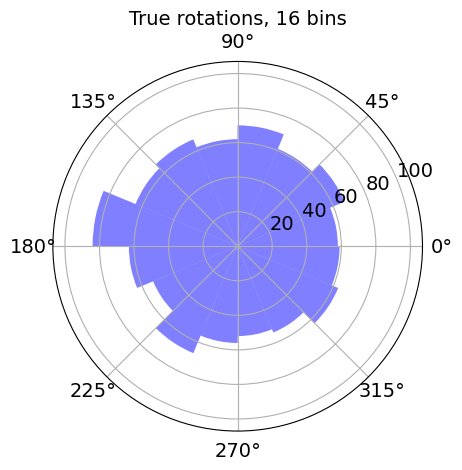

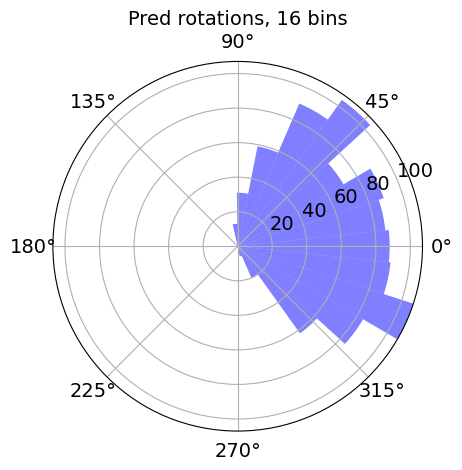

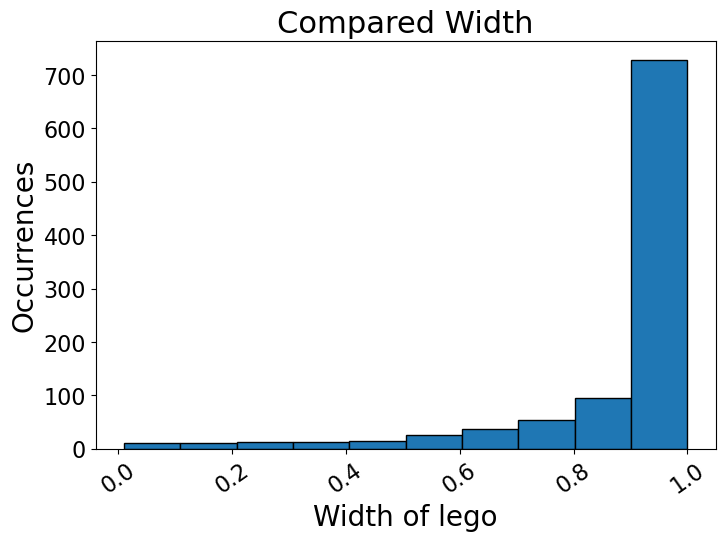

NameError: name 'fig1' is not defined

In [43]:
### # trueData.drop("TrueShape", axis=1)
# print(dfComp["cameraXComp"].hist(xlabelsize=10, ylabelsize=10))

# print(dfComp["LegoYTrue"].hist(xlabel='Y location', xlabelsize=10, ylabelsize=10))
# print(dfComp["LegoYPred"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["LegoYComp"].hist(xlabelsize=10, ylabelsize=10))

#----------------- X LOCATIONS -------------------------------------------------  
def showX():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['LegoXTrue'], edgecolor='black')
    ax1.set_xlabel('Meters from center', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True Lego x locations', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['LegoXPred'], edgecolor='black')
    ax2.set_xlabel('Meters from center', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted Lego x locations', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['LegoXComp'], edgecolor='black')
    ax3.set_xlabel('Meters between predicted and true x locations', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Difference from true Lego x locations', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\histLegoXTrue.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\histLegoXPred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\histLegoXComp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)

#----------------- Y LOCATIONS -------------------------------------------------  
def showY():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['LegoYTrue'], edgecolor='black')
    ax1.set_xlabel('Meters from center', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True Lego y locations', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['LegoYPred'], edgecolor='black')
    ax2.set_xlabel('Meters from center', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted Lego y locations', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['LegoYComp'], edgecolor='black')
    ax3.set_xlabel('Meters between predicted and true y locations', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Difference from true Lego y locations', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\histLegoYTrue.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\histLegoYPred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\histLegoYComp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)

#----------------- WATER HEIGHT -------------------------------------------------  
def showWater():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['WaterHeightTrue'], edgecolor='black', bins=16)
    ax1.set_xlabel('Water height', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True water height', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['WaterHeightPred'], edgecolor='black', bins=16)
    ax2.set_xlabel('Water height', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted water height', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['WaterHeightComp'], edgecolor='black')
    ax3.set_xlabel('Meters between predicted and true height', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Difference from true water height', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\histWaterTrue.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\histWaterPred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\histWaterComp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)


#----------------- WATER HEIGHT -------------------------------------------------  
def showCamX():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['cameraXTrue'], edgecolor='black')
    ax1.set_xlabel('X Location', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True camera x locations', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['cameraXPred'], edgecolor='black')
    ax2.set_xlabel('X Location', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted camera x locations', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['cameraXComp'], edgecolor='black')
    ax3.set_xlabel('Meters from true camera x locations', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Difference from true Lego x locations', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\histCamXTrue.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\histCamXPred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\histCamXComp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)
    
    
def showCamY():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['cameraYTrue'], edgecolor='black')
    ax1.set_xlabel('Y Location', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True camera y locations', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['cameraYPred'], edgecolor='black')
    ax2.set_xlabel('Y Location', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted camera y locations', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['cameraYComp'], edgecolor='black')
    ax3.set_xlabel('Meters from true camera y locations', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Difference from true Lego y locations', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\histCamYTrue.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\histCamYPred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\histCamYComp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)
    
def showCamZ():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['cameraZTrue'], edgecolor='black')
    ax1.set_xlabel('Z Location', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True camera z locations', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['cameraZPred'], edgecolor='black')
    ax2.set_xlabel('Z Location', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted camera z locations', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['cameraZComp'], edgecolor='black')
    ax3.set_xlabel('Meters from true camera z locations', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Difference from true Lego z locations', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\histCamZTrue.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\histCamZPred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\histCamZComp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)

def showLengthDim():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['lego_length_True'], edgecolor='black')
    ax1.set_xlabel('Length of lego', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True Lego length', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['lego_length_Pred'], edgecolor='black')
    ax2.set_xlabel('Length of lego', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted Lego length', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['lego_length_Comp'], edgecolor='black')
    ax3.set_xlabel('Length of lego', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Difference from true Lego length', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\lego_length_True.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\lego_length_Pred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\lego_length_Comp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)

def showWidthDim():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['lego_width_True'], edgecolor='black')
    ax1.set_xlabel('Width of lego', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True Lego width', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['lego_width_Pred'], edgecolor='black')
    ax2.set_xlabel('Width of lego', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted Lego width', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['lego_width_Comp'], edgecolor='black')
    ax3.set_xlabel('Width of lego', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Compared Lego width', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\lego_Width_True.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\lego_Width_Pred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\lego_Width_Comp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)
    
def showHeightDim():
    fig1 = plt.figure(figsize=(8, 6))
    fig1.subplots_adjust(bottom=0.20) 
    ax1 = fig1.add_subplot(1, 1, 1)
    ax1.hist(dfComp['lego_height_True'], edgecolor='black')
    ax1.set_xlabel('Height of lego', fontsize=20)
    ax1.set_ylabel('Occurrences', fontsize=20)
    ax1.set_title('True Lego height', fontsize=22)
    ax1.tick_params(axis='both', which='major', labelsize=16)
    ax1.tick_params(axis='x', rotation=35)
    

    fig2 = plt.figure(figsize=(8, 6))
    fig2.subplots_adjust(bottom=0.20) 
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.hist(dfComp['lego_height_Pred'], edgecolor='black')
    ax2.set_xlabel('Height of lego', fontsize=20)
    ax2.set_ylabel('Occurrences', fontsize=20)
    ax2.set_title('Predicted Lego height', fontsize=22)
    ax2.tick_params(axis='both', which='major', labelsize=16)
    ax2.tick_params(axis='x', rotation=35)
    
    y_max = max(ax1.get_ylim()[1], ax2.get_ylim()[1])
    ax1.set_ylim([0, y_max])
    ax2.set_ylim([0, y_max])
    
    x_max = max(ax1.get_xlim()[1], ax2.get_xlim()[1])
    x_min = min(ax1.get_xlim()[0], ax2.get_xlim()[0])
    ax1.set_xlim([x_min, x_max])
    ax2.set_xlim([x_min, x_max])

    fig3 = plt.figure(figsize=(8, 6))
    fig3.subplots_adjust(bottom=0.20) 
    ax3 = fig3.add_subplot(1, 1, 1)
    ax3.hist(dfComp['lego_height_Comp'], edgecolor='black')
    ax3.set_xlabel('Height of lego', fontsize=20)
    ax3.set_ylabel('Occurrences', fontsize=20)
    ax3.set_title('Difference from true Lego height', fontsize=22)
    ax3.tick_params(axis='both', which='major', labelsize=16)
    ax3.tick_params(axis='x', rotation=35)
    
    
    fig1.savefig(picture_folder + 'temp\\lego_height_True.png', dpi=300)
    fig2.savefig(picture_folder + 'temp\\lego_height_Pred.png', dpi=300)
    fig3.savefig(picture_folder + 'temp\\lego_height_Comp.png', dpi=300)
    
    plt.close(fig3)
    plt.close(fig2)
    plt.close(fig1)
    
# print(dfComp["LegoRotComp"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["lego_width_Comp"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["lego_width_True"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["lego_width_Pred"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["WaterHeightComp"].mean())
# print(dfComp["WaterHeightComp"].std())
# print(dfComp["WaterHeightComp"].hist(xlabelsize=10, ylabelsize=10, bins=20))
# print(dfComp["LightX"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["LightY"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["cameraX"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["cameraY"].hist(xlabelsize=10, ylabelsize=10))
# print(dfComp["cameraZ"].hist(xlabelsize=10, ylabelsize=10))

# rose_plot(trueData["LegoRot"])


# ASK ABOUT THIS
# fig, ax = plt.subplots(1, subplot_kw=dict(projection='polar'))

# rose_plot(ax, dfComp["LegoRotComp"])
# plt.savefig(f'{picture_folder}temp\\histRotComp.jpg')

# rose_plot(ax, dfComp["LegoRotPred"])
# plt.savefig(f'{picture_folder}temp\\histRotPred.jpg')

# rose_plot(ax, dfComp["LegoRotTrue"])
# plt.savefig(f'{picture_folder}temp\\histRotTrue.jpg')

# rose_plot(ax[1], angles1)

# fig.tight_layout()

# polar_plot(dfComp['LegoRotTrue'], 24)
# compute the maximum count across both data frames
max_count = np.max([np.histogram(dfComp['LegoRotTrue'], bins=16)[0], np.histogram(dfComp['LegoRotPred'], bins=16)[0]])

# create the first polar histogram and save it
polar_plot(dfComp, 'LegoRotTrue', 16, save_fig=True, max_count=max_count, title="True rotations")

# create the second polar histogram
polar_plot(dfComp, 'LegoRotPred', 16, save_fig=True, max_count=max_count, title="Pred rotations")

fig = plt.figure(figsize=(8, 6))
fig.subplots_adjust(bottom=0.20) 
ax = fig.add_subplot(1, 1, 1)
ax.hist(dfComp['LegoRotComp'].abs(), edgecolor='black')
ax.set_xlabel('Width of lego', fontsize=20)
ax.set_ylabel('Occurrences', fontsize=20)
ax.set_title('Compared Width', fontsize=22)
ax.tick_params(axis='both', which='major', labelsize=16)
ax.tick_params(axis='x', rotation=35)
fig.savefig(picture_folder + 'temp\\lego_Width_True.png', dpi=300)
plt.show()
plt.close(fig)
# polar_plot(dfComp, 'LegoRotComp', 16, save_fig=True, title="Comp rotations")

# print(dfComp['LegoRotComp'].min())

showX()
showY()
showCamX()
showCamY()
showCamZ()
showWater()
showLengthDim()
showWidthDim()
showHeightDim()

def scatterMatrix():
    df = dfComp[['LegoYComp', 'LegoXComp', 'WaterHeightTrue', 'WaterHeightPred']]
    pd.plotting.scatter_matrix(df)
#     print(df)
# dfComp.plot.scatter(x='WaterHeightPred', y='WaterHeightTrue', c='DarkBlue')
# scatterMatrix()
# print(dfComp['LegoYTrue'].corr(dfComp['LegoYPred']))
print("---")

   RefractedDistance  PredictionMiss     error  WaterHeight
0           0.342348        0.136568  0.205780     1.302842
1           0.142935        0.302304  0.159369     1.130385
2           0.120259        0.280638  0.160379     0.540674
3           0.283522        0.222427  0.061095     1.421170
4           0.021199        0.394626  0.373427     0.480067


array([[<AxesSubplot:xlabel='RefractedDistance', ylabel='RefractedDistance'>,
        <AxesSubplot:xlabel='PredictionMiss', ylabel='RefractedDistance'>,
        <AxesSubplot:xlabel='error', ylabel='RefractedDistance'>,
        <AxesSubplot:xlabel='WaterHeight', ylabel='RefractedDistance'>],
       [<AxesSubplot:xlabel='RefractedDistance', ylabel='PredictionMiss'>,
        <AxesSubplot:xlabel='PredictionMiss', ylabel='PredictionMiss'>,
        <AxesSubplot:xlabel='error', ylabel='PredictionMiss'>,
        <AxesSubplot:xlabel='WaterHeight', ylabel='PredictionMiss'>],
       [<AxesSubplot:xlabel='RefractedDistance', ylabel='error'>,
        <AxesSubplot:xlabel='PredictionMiss', ylabel='error'>,
        <AxesSubplot:xlabel='error', ylabel='error'>,
        <AxesSubplot:xlabel='WaterHeight', ylabel='error'>],
       [<AxesSubplot:xlabel='RefractedDistance', ylabel='WaterHeight'>,
        <AxesSubplot:xlabel='PredictionMiss', ylabel='WaterHeight'>,
        <AxesSubplot:xlabel='error', ylabel

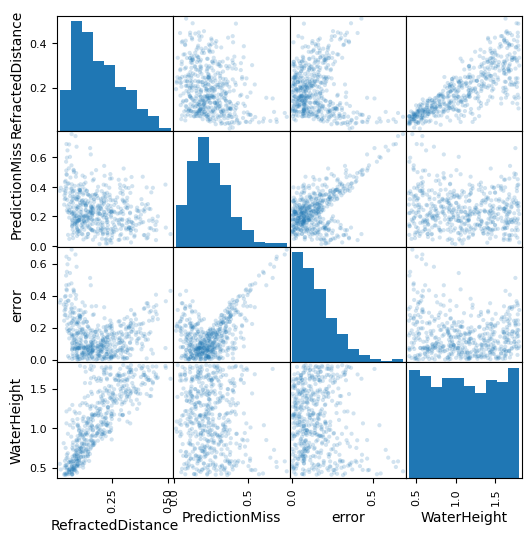

In [70]:
data = pd.read_csv(f"{picture_folder}Metadata\\DistanceData.csv")
print(data.head())
#pd.plotting.scatter_matrix(data,figsize=(4,4),grid=True,marker='o')
pd.plotting.scatter_matrix(data, alpha = 0.2, figsize = (6, 6), diagonal = 'hist')

In [13]:
model = tf.keras.models.load_model(
    #"C:\\Users\\Matias\\_Thesis\\Project-Blender\\Pictures\\Models\\model_best.h5", custom_objects={ 'loss':losses, 'loss_weights':lossWeights}, compile=True
    f"{picture_folder}Models\\model_best.h5", custom_objects={ 'loss':losses, 'loss_weights':lossWeights}, compile=True
)

In [2]:


preds = x_val[:numPredictions]
labels = y_val[:numPredictions]
print(np.shape(y_val[0]))
predictions = model.predict(preds)
print(predictions[2][0])
# print(y_val[0])
actual = labels
# print([x[3] for x in predictions])
#for i in range(len(predictions)):
#    print("num", i)
#print(actual[0])
#print(predictions[5])
#tmp = tf.where(predictions[5] < 0.5, 0., 1.)
#print(tmp[1])
#x = [i[0] for i in predictions[0]]
#y = [i[1] for i in predictions[0]]
#print(backend.sigmoid(5.0))

# act_x = [i[0] for i in actual]
# act_y = [i[1] for i in actual]

#print(act_x)
#print(act_y)
#print(predictions[2])
#msd = backend.mean(tf.math.squared_difference(x, act_x), axis=-1)
#print("msd:", msd)
#actual_msd = backend.mean(tf.math.squared_difference(x, y), axis=-1)
#for i in predictions[0]:
#    print(i)
#print(predictions)
#    
# print(y_val[1])
#print(temp)

NameError: name 'x_val' is not defined

In [1]:
# real_demo_pic = Image.open("C:\\Users\\Matias\\_Thesis\\pictures\\Real\\demo2.png").convert('RGB')
# real_demo_pic = Image.open(f"{picture_folder}Real\\01_zoomed.jpg").convert('RGB')

# preds = x_val[:numPredictions]
# labels = y_val[:numPredictions]
# print(np.shape(y_val[0]))
# predictions = model.predict(preds)

img = x_val[0:5]#Image.open(f"{picture_folder}Autogenerated\\image_133.png").convert('RGB')
# display(img)
# img -= np.mean(img, axis=0)
# img /= np.std(img, axis=0)
# img *= 0.1
# img += 0.3

# img = [img]

print(np.shape(img))
    
prediction = model.predict(img[0])

# real_demo_pic = Image.open(f"{picture_folder}Autogenerated\\image_123.png").convert('RGB')

# display(img)
# real_demo_pic_resized = real_demo_pic.resize((256, 256), resample=Image.BICUBIC)
# display(real_demo_pic_resized)
# print(model.predict( np.array( [np.array(real_demo_pic_resized),] )  ))
# Note to self
# Model seems to have learnt location relative to camera
# Start generating data with differing camera positions

NameError: name 'x_val' is not defined

In [10]:
test_predictions, loss = model.predict(x_val) #see what predict returns
#test_loss, test_acc = model.evaluate(x_val, y_val, verbose=0)
best_predictions = np.argsort(test_predictions)[-10:]
worst_predictions = np.argsort(test_predictions)[:10]

38/38 [==============================] - 4s 94ms/step


In [36]:
def threshold(x):
  return tf.where(x < 0.5, 0., 1.)

# Example usage:
tensor = tf.constant([0.1, 0.3, 0.6, 0.9, 1.2])
result = threshold(tensor)
print(result)

tf.Tensor([0. 0. 1. 1. 1.], shape=(5,), dtype=float32)
